In [53]:
# load modules
import os
import sys
import gzip
import numpy as np
import scipy.stats as stats
import pandas as pd
import pickle
import anndata
import scanpy as sc
import scipy
import seaborn as sns
import pdb

import collections
from scipy.io import mmread,mminfo
from sklearn.decomposition import PCA

import matplotlib.pyplot as plt

from sklearn.neighbors import NearestNeighbors


In [54]:
#cell_dic
markers_df = pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/bc_signatures - version_0119.csv')#pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/bc_signatures - version_0119.csv')#pd.read_csv('/Users/xueerchen/Downloads/bc_signatures - Overall_sorted_1121.csv')#pd.read_csv('signature_v1_res/BC_cellsignatures_final.csv')#pd.read_csv('signature_v1_res/BC_cellsignatures_mod.csv')#pd.read_csv('/Users/xueerchen/Documents/spatial/bc/Tcellsignatures_june2020.csv')##('mouse_brain_marker_gene-SH.csv')

#markers_df = pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v3_res/bc_signatures - version_1216.csv')#pd.read_csv('/Users/xueerchen/Downloads/bc_signatures - Overall_sorted_1121.csv')#pd.read_csv('signature_v1_res/BC_cellsignatures_final.csv')#pd.read_csv('signature_v1_res/BC_cellsignatures_mod.csv')#pd.read_csv('/Users/xueerchen/Documents/spatial/bc/Tcellsignatures_june2020.csv')##('mouse_brain_marker_gene-SH.csv')
cells = markers_df.columns.values
marker_genes = []
#cell_dic = {}
cell_dic_plot = {}
for c in cells:
    cc = np.array(markers_df[c].values.tolist())
    marker_genes = np.append(marker_genes,[x for x in cc if str(x) != 'nan'])
    #cell_dic[c] = [x for x in cc if str(x) != 'nan']
    cell_dic_plot[c] = [x for x in cc if str(x) != 'nan']
  

In [55]:
cells

array(['T_cells_c0_CD4+_CCR7', 'T_cells_c1_CD4+_IL7R',
       'T_cells_c3_CD4+_Tfh_CXCL13', 'T_cells_c2_CD4+_T-regs_FOXP3',
       'B_cells_Memory', 'B_cells_Naive', 'NK', 'Macrophage_M1',
       'Macrophage_M2', 'Endothelial', 'MDSC', 'MBC', 'TNBC',
       'CD8_T_cell_activation', 'CD8+_deletional_tolerance',
       'CD8+_TIL_dysfunction', 'cDC', 'pDC', 'Terminal_exhaustion',
       'Precursor_exhaustion', 'CAFs_MSC_iCAF-like', 'CAFs_myCAF-like',
       'PVL_Differentiated', 'PVL_Immature', 'Normal_epithelial',
       'Plasmablasts'], dtype=object)

In [56]:
sampleA_path = "data/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient1A_012020_IGO_10778_1/outs/"#'/home/jiwei/miao/bc_visium/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2A_021120_IGO_10778_3/outs/' #path to directory with 'spatial' file
sampleA_count = 'filtered_feature_bc_matrix.h5'
adA = sc.read_visium(path=sampleA_path, count_file = sampleA_count, library_id='1A')
adA.var_names_make_unique()


sample_path = "data/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient1B_012020_IGO_10778_2/outs/"#"/home/jiwei/miao/bc_visium_mod/data/Reosis_AA8934_TS-Reosis_1_A1_IGO_11934_1/"#'/home/jiwei/miao/bc_visium/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2A_021120_IGO_10778_3/outs/' #path to directory with 'spatial' file
sample_count = 'filtered_feature_bc_matrix.h5'
adB = sc.read_visium(path=sample_path, count_file = sample_count, library_id='1B')#sc.read_visium(path=sample1_path, count_file = sample1_count, library_id='Reosis_AA8934_TS-Reosis_1_A1_IGO_11934_1')
adB.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... storing 'feature_types' as categorical
... storing 'genome' as categorical


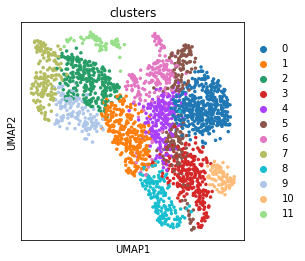

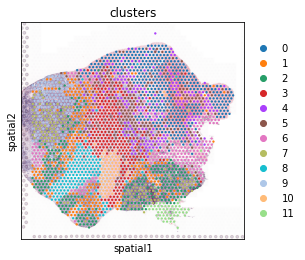

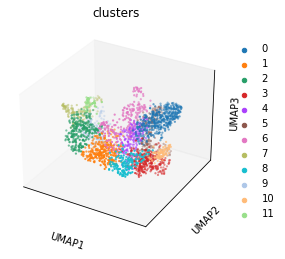

In [57]:
sc.pp.normalize_total(adA, inplace=True)
sc.pp.log1p(adA)
sc.pp.highly_variable_genes(adA, flavor="seurat", n_top_genes=5000, inplace=True)

sc.pp.pca(adA)
sc.pp.neighbors(adA)
sc.tl.umap(adA)
sc.tl.leiden(adA, key_added="clusters")


sc.pl.umap(adA, color=["clusters"], wspace=0.4)

sc.pl.spatial(
        adA,
        img_key="hires",
        
        color="clusters"
    )

sc.tl.umap(adA,n_components=3)
sc.tl.leiden(adA, key_added="clusters")
plt.rcParams["figure.figsize"] = (4, 4)
sc.pl.umap(adA, color=["clusters"], wspace=0.4,projection='3d')



... storing 'feature_types' as categorical
... storing 'genome' as categorical


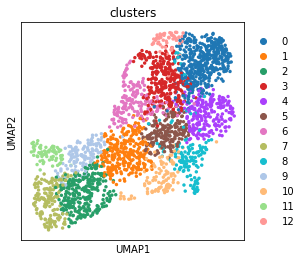

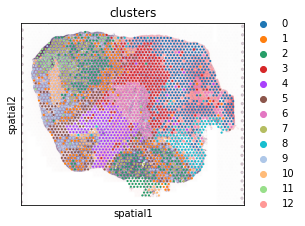

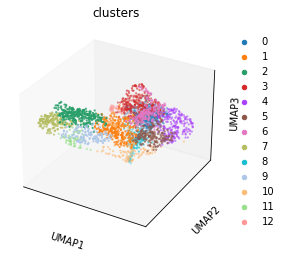

In [58]:
sc.pp.normalize_total(adB, inplace=True)
sc.pp.log1p(adB)
sc.pp.highly_variable_genes(adB, flavor="seurat", n_top_genes=5000, inplace=True)

sc.pp.pca(adB)
sc.pp.neighbors(adB)
sc.tl.umap(adB)
sc.tl.leiden(adB, key_added="clusters")


sc.pl.umap(adB, color=["clusters"], wspace=0.4)

sc.pl.spatial(
        adB,
        img_key="hires",
        
        color="clusters"
    )

sc.tl.umap(adB,n_components=3)
sc.tl.leiden(adB, key_added="clusters")
plt.rcParams["figure.figsize"] = (4, 4)
sc.pl.umap(adB, color=["clusters"], wspace=0.4,projection='3d')




In [59]:
exp_df_B = pd.DataFrame.sparse.from_spmatrix(adB.X)
exp_df_B.index = adB.obs.index
exp_df_B.columns = adB.var.index
#exp_df_B.head()

RPS_genes = [i for i in exp_df_B.columns.values if i.startswith('RPS')]
print(len(RPS_genes))
RPL_genes = [i for i in exp_df_B.columns.values if i.startswith('RPL')]
print(len(RPL_genes))
MT_genes = [i for i in exp_df_B.columns.values if i.startswith('MT-')]
print(len(MT_genes))

print(exp_df_B.shape)
exp_df_B.drop(RPS_genes, axis=1,inplace=True)#df.drop(['B', 'C'], axis=1)
print(exp_df_B.shape)
exp_df_B.drop(RPL_genes, axis=1,inplace=True)
print(exp_df_B.shape)
exp_df_B.drop(MT_genes, axis=1,inplace=True)
print(exp_df_B.shape)

exp_df_B[exp_df_B.columns.intersection(set(marker_genes))].to_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/markers_df_gsva_1B_v5.csv')



48
56
13
(2551, 33538)
(2551, 33490)
(2551, 33434)
(2551, 33421)


In [60]:
import scipy.sparse

exp_df = pd.DataFrame.sparse.from_spmatrix(adA.X)
exp_df.index = adA.obs.index
exp_df.columns = adA.var.index
exp_df.head()

RPS_genes = [i for i in exp_df.columns.values if i.startswith('RPS')]
print(len(RPS_genes))
RPL_genes = [i for i in exp_df.columns.values if i.startswith('RPL')]
print(len(RPL_genes))
MT_genes = [i for i in exp_df.columns.values if i.startswith('MT-')]
print(len(MT_genes))

print(exp_df.shape)
exp_df.drop(RPS_genes, axis=1,inplace=True)#df.drop(['B', 'C'], axis=1)
print(exp_df.shape)
exp_df.drop(RPL_genes, axis=1,inplace=True)
print(exp_df.shape)
exp_df.drop(MT_genes, axis=1,inplace=True)
print(exp_df.shape)
exp_df[exp_df.columns.intersection(set(marker_genes))].to_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/markers_df_gsva_1A_v5.csv')

48
56
13
(2454, 33538)
(2454, 33490)
(2454, 33434)
(2454, 33421)


In [61]:
# markers_gsva_1A_individual.csv
gsva_scores1 = pd.read_csv('signature_v5_res/markers_gsva_1A_individual_mod.csv',index_col=0)#pd.read_csv('signature_v2_res/markers_gsva_1A.csv',index_col=0)#pd.read_csv('signature_v1_res/markers_gsva_1A.csv',index_col=0)
gsva_scores2 = pd.read_csv('signature_v5_res/markers_gsva_1A_individual_mod.csv',index_col=0)#pd.read_csv('signature_v2_res/markers_gsva_1A.csv',index_col=0)#pd.read_csv('signature_v1_res/markers_gsva_1A.csv',index_col=0)
gsva_scores3 = pd.read_csv('signature_v5_res/markers_gsva_1A_individual_mod.csv',index_col=0)#pd.read_csv('signature_v2_res/markers_gsva_1A.csv',index_col=0)#pd.read_csv('signature_v1_res/markers_gsva_1A.csv',index_col=0) # for training BCE loss
#gsva_scores
gsva_scores1.columns = gsva_scores1.columns.str.replace(' ', '')
gsva_scores2.columns = gsva_scores2.columns.str.replace(' ', '')
gsva_scores3.columns = gsva_scores3.columns.str.replace(' ', '')

#gsva_scores1 = gsva_scores1.drop(columns=['Treg','Her2E_SC2','LumA_SC2', 'LumB_SC2'])#,'Treg''Th17','CD4+_Tcell_anergy'
#gsva_scores2 = gsva_scores2.drop(columns=['Treg','Her2E_SC2','LumA_SC2', 'LumB_SC2'])
#gsva_scores3 = gsva_scores3.drop(columns=['Treg','Her2E_SC2','LumA_SC2', 'LumB_SC2'])

for i in gsva_scores1.columns:
    
    gsva_scores2.loc[gsva_scores1[i] >= gsva_scores1[i].quantile(0.9995), i] = 1#0.9999   
    gsva_scores2.loc[(gsva_scores1[i] > gsva_scores1[i].quantile(0.92))&(gsva_scores1[i] < gsva_scores1[i].quantile(0.9995)), i] = 2
    gsva_scores2.loc[gsva_scores1[i] < gsva_scores1[i].quantile(0.92), i] = 0


    gsva_scores3.loc[gsva_scores1[i] >= gsva_scores1[i].quantile(0.7), i] = 1#0.9999   
    
    gsva_scores3.loc[gsva_scores1[i] < gsva_scores1[i].quantile(0.7), i] = 0
    
    #gsva_scores2.loc[gsva_scores1[i] >= gsva_scores1[i].quantile(0.999), i] = 1#0.9999   
    #gsva_scores2.loc[(gsva_scores1[i] > gsva_scores1[i].quantile(0.99))&(gsva_scores1[i] < gsva_scores1[i].quantile(0.999)), i] = 2
    #gsva_scores2.loc[gsva_scores1[i] < gsva_scores1[i].quantile(0.99), i] = 0



In [62]:
gsva_scores1.shape

(2454, 26)

In [63]:
gsva_scores1.columns

Index(['B_cells_Memory', 'B_cells_Naive', 'CAFs_MSC_iCAF-like',
       'CAFs_myCAF-like', 'CD8_T_cell_activation', 'CD8+_deletional_tolerance',
       'CD8+_TIL_dysfunction', 'cDC', 'Endothelial', 'Macrophage_M1',
       'Macrophage_M2', 'MBC', 'MDSC', 'NK', 'Normal_epithelial', 'pDC',
       'Plasmablasts', 'Precursor_exhaustion', 'PVL_Differentiated',
       'PVL_Immature', 'T_cells_c0_CD4+_CCR7', 'T_cells_c1_CD4+_IL7R',
       'T_cells_c2_CD4+_T-regs_FOXP3', 'T_cells_c3_CD4+_Tfh_CXCL13',
       'Terminal_exhaustion', 'TNBC'],
      dtype='object')

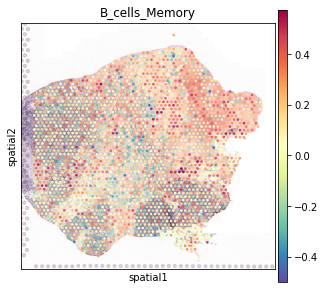

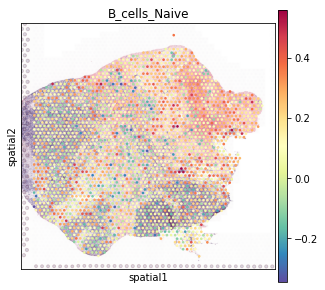

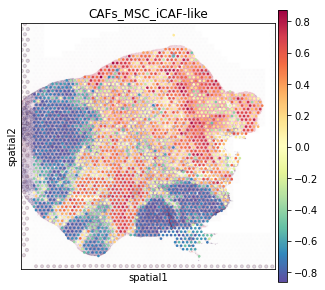

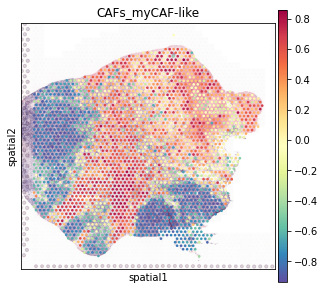

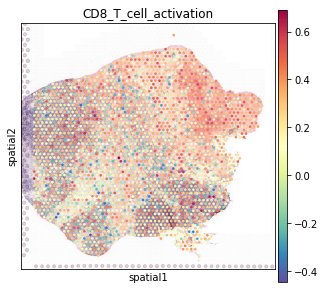

...

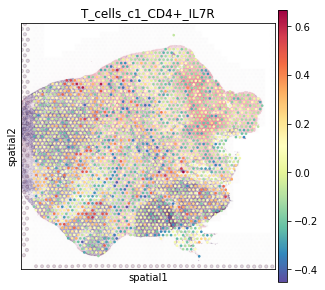

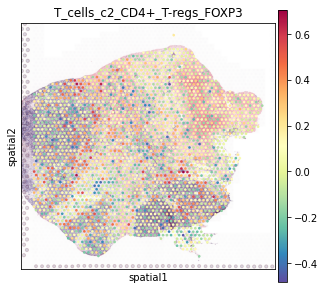

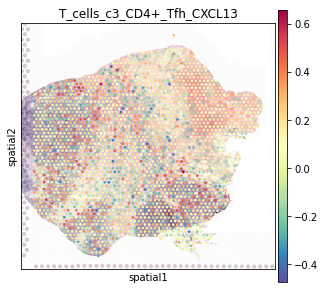

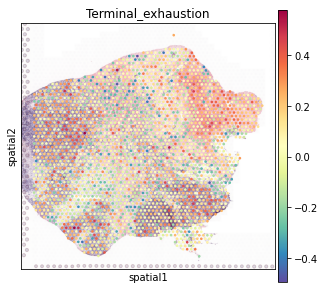

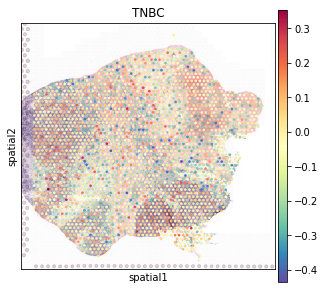

In [64]:
plt.rcParams["figure.figsize"] = (5, 5)
for ii in gsva_scores1.columns:
        adA.obs[ii+'_gsva'] = gsva_scores1[ii].values
        sc.pl.spatial(
        adA,
        img_key="hires",
        title=ii,
        color=ii+'_gsva',cmap='Spectral_r'#'cividis'
        
    )




In [65]:
#adA.obs.index = adA.obs.index+'_1A'

In [66]:
arches_val_ct = []

arch_spots_ct = []
#archs = []
spot_sizes_ct = []
cts_ct = []
#archs = []
for i in adA.obs.index:
    ds = gsva_scores2.loc[i+'_1A',:]
    mask = ds == 1
    tmp = ds.loc[mask].index
    if len(tmp)==1:
        ct = tmp.values
        arches_val_ct = np.append(arches_val_ct,ct)
        arch_spots_ct = np.append(arch_spots_ct,i)
        #archs = np.append(archs,int(ct.split('_')[1]))
        spot_sizes_ct = np.append(spot_sizes_ct,500)
        
        
    else:
        arches_val_ct = np.append(arches_val_ct,'nan')
        spot_sizes_ct = np.append(spot_sizes_ct,50)
        
# nn
arches_nn_ct = []
arch_nn_spots_ct = []

for i in adA.obs.index:
    ds = gsva_scores2.loc[i+'_1A',:]
    mask = ds == 2
    tmp = ds.loc[mask].index
    if len(tmp)==1:
        ct = tmp.values
        arches_nn_ct = np.append(arches_nn_ct,ct)
        arch_nn_spots_ct = np.append(arch_nn_spots_ct,i)
        
    else:
        arches_nn_ct = np.append(arches_nn_ct,'nan')
        
 



In [67]:
adA.obs['arches_val_ct'] = arches_val_ct#adA.obs['arches_nn_val'] = arches_val
adA.obs['arches_nn_ct'] = arches_nn_ct

print(adA.obs['arches_val_ct'].value_counts())
adA.obs['arches_nn_ct'].value_counts()

nan                             2415
PVL_Differentiated                 2
pDC                                2
PVL_Immature                       2
MDSC                               2
NK                                 2
MBC                                2
Endothelial                        2
Normal_epithelial                  2
CD8+_deletional_tolerance          2
CAFs_myCAF-like                    2
CAFs_MSC_iCAF-like                 2
Precursor_exhaustion               2
Plasmablasts                       2
TNBC                               2
Terminal_exhaustion                2
CD8_T_cell_activation              2
CD8+_TIL_dysfunction               2
Macrophage_M1                      1
T_cells_c1_CD4+_IL7R               1
T_cells_c2_CD4+_T-regs_FOXP3       1
B_cells_Naive                      1
cDC                                1
Name: arches_val_ct, dtype: int64


nan                             1809
cDC                               54
Endothelial                       45
pDC                               39
CAFs_MSC_iCAF-like                39
TNBC                              38
Plasmablasts                      36
CD8_T_cell_activation             36
MDSC                              36
CAFs_myCAF-like                   33
Precursor_exhaustion              33
Normal_epithelial                 30
PVL_Immature                      26
NK                                24
CD8+_deletional_tolerance         20
Terminal_exhaustion               20
PVL_Differentiated                19
MBC                               18
Macrophage_M1                     17
B_cells_Naive                     15
CD8+_TIL_dysfunction              13
T_cells_c0_CD4+_CCR7              11
Macrophage_M2                     11
T_cells_c3_CD4+_Tfh_CXCL13         9
B_cells_Memory                     9
T_cells_c2_CD4+_T-regs_FOXP3       8
T_cells_c1_CD4+_IL7R               6
N

In [68]:
#tmp = pd.DataFrame(adA.X,index=adA.obs.index.values,columns=adA.var.index.values)
tmp = exp_df
tmp.index.name = 'cell_id'#tmp.index.name = 'cell_id'
#print(tmp.shape)
genes_sele = np.append(adA.var.loc[adA.var['highly_variable'] == True].index.values,marker_genes)
dt = tmp[tmp.columns.intersection(genes_sele)]
dt.shape


genes = dt.columns.values

#valid_cell_dic_all = {}

valid_cell_dic_ct = {}
for c,m1 in cell_dic_plot.items():
    m2 = [i for i in m1 if i in genes]
    #print(c,m2)
    if len(m2)>0:
        valid_cell_dic_ct[c] = m2
        #valid_cell_dic_all[c] = m2



B = dt.to_numpy()#ad1.obsm['X_umap']#np.array([[1,4],[2,5],[3,6]])
A = np.array(XC.T)#XC.T#np.array([[1,4],[3,6],[7,8]]) A, = np.array(M.T)

dist = np.linalg.norm(np.expand_dims(A,axis=1)-np.expand_dims(B,axis=0),axis=2)
dist.shape
print(A.shape,B.shape)
dist_df = pd.DataFrame(dist, index=[f'cell_{i}' for i in range(1,no_c+1)],columns =adA.obs.index)
dist_df_t=dist_df.T
arches_val = []
arches_nn = []
arch_spots = []
archs = []
spot_sizes = []
#archs = []
for i in adA.obs.index:
    # first find min dist of arche for current spot
    ct = dist_df.index[dist_df[i].argsort()[0]]
    # check if in the closest 60 spots for that arche
    if i in dist_df_t.sort_values(by=[ct], ascending= 1).index[1:2]:#dist_df.loc[ct].argsort()[0:30].index:#wass_dist_df.loc[ct].argsort()[0:59].index:
        arches_val = np.append(arches_val,ct)
        arch_spots = np.append(arch_spots,i)
        archs = np.append(archs,int(ct.split('_')[1]))
        spot_sizes = np.append(spot_sizes,500)
    else:
        arches_val = np.append(arches_val,'nan')
        spot_sizes = np.append(spot_sizes,50)
        
    if i in dist_df_t.sort_values(by=[ct], ascending= 1).index[1:30]:#dist_df.loc[ct].argsort()[0:30].index:#wass_dist_df.loc[ct].argsort()[0:59].index:
        arches_nn = np.append(arches_nn,ct)
    else:
        arches_nn = np.append(arches_nn,'nan')

adA.obs['arches_val'] = arches_val#adA.obs['arches_nn_val'] = arches_val

adA.obs['arches_nn'] = arches_nn

In [69]:
# fix prior var calculation
# var: average expression of signature genes, var across NN
vars_arch_ct = []
tt = adA.obs
ttt = np.array(tt['arches_nn_ct'].unique())
#x[~numpy.isnan(x)]
for i in cells:#gsva_scores1.columns:#cell_dic_plot.keys():#valid_cell_dic_ct.keys():#ttt[~np.isnan(ttt)]:#cell_dic_plot.keys():
    
    mask = tt['arches_nn_ct']==i
    spots = tt.loc[mask].index.values#adA.obs.loc[:,dA.obs.loc['arches_nn']].index.values()# df1.loc[:, df1.loc['a'] > 0]
    genes_sele = cell_dic_plot[i]
    var_n = np.sqrt(exp_df.loc[spots][exp_df.columns.intersection(genes_sele)].sum(axis=1).var())
    vars_arch_ct = np.append(vars_arch_ct,var_n)
    
vars_arch_ct

array([2.50368884, 2.9257348 , 1.46975115, 1.81526507, 6.78983732,
       5.55203052, 1.76575708, 7.29401465, 5.74467845, 9.6126385 ,
       0.92557133, 0.861369  , 4.88494367, 1.7198638 , 1.36398452,
       1.38674799, 0.67346869, 0.80939622, 2.43312646, 1.55922486,
       5.51821371, 5.65679047, 4.76369964, 5.49618367, 1.33375019,
       4.24742204])

In [70]:
from __future__ import print_function, division

import os
GPU_id = 0
os.environ['CUDA_VISIBLE_DEVICES'] = str(GPU_id)
import os
import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.autograd import Variable

import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset
import matplotlib.pyplot as plt

#import torchvision.datasets as datasets
from torch.utils.data import Dataset, DataLoader
#from torchvision import transforms, utils

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [71]:
class visiumDataset(Dataset):

    def __init__(self, exp_mat, transform=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.spot_gene_exp = exp_mat
        idx = self.spot_gene_exp.index
        x = self.spot_gene_exp.values
        #x = np.log1p(x)
        self.spot_gene_exp = pd.DataFrame(x, columns=self.spot_gene_exp.columns, index=idx)
            
        #self.root_dir = root_dir
        #self.transform = transform

    def __len__(self):
        return len(self.spot_gene_exp)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        sample = torch.Tensor(np.array(self.spot_gene_exp.iloc[idx,0:],dtype='float'))
        
        return sample





In [72]:
class VAE(nn.Module):
    def __init__(self,H,M,vars_arch_ct):
        super(VAE,self).__init__()

        self.vars_arch_ct = torch.from_numpy(vars_arch_ct).float()
        
        
        self.encoder = nn.Sequential(
            nn.Linear(M,128),#nn.Linear(M,40),#nn.Linear(M,400),
            nn.ReLU(),
            nn.Linear(128,H),#nn.Linear(40,H),#nn.Linear(400,H)
            #nn.ReLU(),
        )
        
        
        self.fc_mu_w = torch.nn.Parameter(torch.rand(H,H))
        self.fc_mu_b = torch.nn.Parameter(torch.rand(H))
        
         
        self.decoder = nn.Sequential(
            #nn.Linear(H,H),#50
            #nn.ReLU(),
            nn.Linear(H,128),#nn.Linear(H,40),#nn.Linear(H,400)
            nn.ReLU(),
            nn.Linear(128,M),#nn.Linear(40,M),#nn.Linear(400,6000)
        )
        
        # for the gaussian likelihood ????
        self.log_scale = nn.Parameter(torch.Tensor([0.0]))
        
        
    def forward(self, x, sample_cell_genes, captum_only=False):
        # encode x to get the mu and variance parameters
        x_encoded = self.encoder(x)
        x_sample_cell = self.encoder(sample_cell_genes)#torch.eye(len(valid_cell_dic)).cuda()#self.encoder(sample_cell_genes)#*torch.eye(len(valid_cell_dic)).cuda()# multiply by identity mat or assign one identity mat directly
        #x_sample_cell_ct = self.encoder(sample_cell_genes_ct)
        
        mu = torch.matmul(x_encoded, self.fc_mu_w) + self.fc_mu_b#torch.matmul(x_encoded, self.fc_mu_w+x_sample_cell.T) + self.fc_mu_b
        #log_var = torch.matmul(x_encoded, self.fc_var_w) + self.fc_var_b#torch.matmul(x_encoded, self.fc_var_w+x_sample_cell.T) + self.fc_var_b
       
        mu_samp = torch.matmul(x_sample_cell, self.fc_mu_w) + self.fc_mu_b
        #print(mu_samp.shape)
        tt = torch.tensor(self.vars_arch_ct)#self.vars_arch
        #print(len(tt))
        std_samp = tt.repeat(mu_samp.shape[0], 1)#0.01*torch.ones(mu_samp.shape[0],mu_samp.shape[1]).cuda()#tt.repeat(mu_samp.shape[0], 1)#torch.exp(log_var_samp / 2)#0.1*torch.ones(mu_samp.shape[0],mu_samp.shape[1])#torch.exp(log_var_samp / 2)
        # sample z from q
        std = tt.repeat(mu.shape[0], 1)#0.01*torch.ones(mu.shape[0],mu.shape[1]).cuda()#tt.repeat(mu.shape[0], 1)
        
        #std_samp = torch.exp(log_var_samp / 2)
        # sample z from q
        #std = torch.exp(log_var / 2)
        eps = torch.randn_like(std)
        #z = mu + (eps*std)
        q = torch.distributions.Normal(mu, std)
        z = q.rsample()
        
        q_samp = torch.distributions.Normal(mu_samp, std_samp)
        z_samp = q_samp.rsample()
        
        #z_samp = torch.eye(len(valid_cell_dic)).cuda()#np.identity(len(valid_cell_dic))

        # decoded 
        x_samp_hat = vae.decoder(z_samp)
        x_hat = vae.decoder(z) #?? self.
        if captum_only:
            return x_hat
        else:
            return x_encoded,x_sample_cell,x_hat,x_samp_hat,z,z_samp,mu,std,mu_samp,std_samp
        #return x_encoded,x_sample_cell,x_hat,x_samp_hat,z,z_samp,mu,std,mu_samp,std_samp
        

In [73]:
def gaussian_likelihood(mean, logscale, sample):
    scale = torch.exp(logscale)
    dist = torch.distributions.Normal(mean, scale)
    log_pxz = dist.log_prob(sample)
    return log_pxz.sum(dim=1)

def kl_divergence(z, mu, std):
    # --------------------------
    # Monte carlo KL divergence
    # --------------------------
    # 1. define the first two probabilities (in this case Normal for both)
    p = torch.distributions.Normal(torch.zeros_like(mu), torch.ones_like(std))
    q = torch.distributions.Normal(mu, std)

    # 2. get the probabilities from the equation
    log_qzx = q.log_prob(z)
    log_pz = p.log_prob(z)

    # kl
    kl = (log_qzx - log_pz)
    kl = kl.sum(-1)
    return kl

In [74]:

#tmp = pd.DataFrame(adA.X,index=adA.obs.index.values,columns=adA.var.index.values)
tmp = exp_df
tmp.index.name = 'cell_id'#tmp.index.name = 'cell_id'
#print(tmp.shape)
genes_sele = np.append(adA.var.loc[adA.var['highly_variable'] == True].index.values,marker_genes)
dt = tmp[tmp.columns.intersection(genes_sele)]
dt.shape


#xx = dt.loc[[emptyDict[k] for k in list(valid_cell_dic.keys()) ]]
#dt = tmp[tmp.columns.intersection(ad1.var.loc[ad1.var['highly_variable'] == True].index.values)]
vd = visiumDataset(exp_mat=dt)#visiumDataset(exp_mat=xx.loc[xx.index.repeat(100)])#visiumDataset(exp_mat=dt)#visiumDataset(exp_mat=xx.loc[xx.index.repeat(10)])#visiumDataset(exp_mat=dt)#visiumDataset(exp_mat=dt)

import matplotlib.pyplot as plt
#plt.hist(dt.sum(axis=1))
#plt.show()

batch_size = 128

train_loader = torch.utils.data.DataLoader(
                 dataset=vd,#dataset=train_set,
                 batch_size=batch_size,
                 shuffle=True,
                 num_workers=8,
                 #prefetch_factor=64,
)

x = next(iter(train_loader))
x.shape

print(x.min(), x.max(), x.mean())

x.shape, x.dtype

tensor(0.) tensor(6.3464) tensor(0.1084)


(torch.Size([128, 5406]), torch.float32)

In [75]:
new_index = []
for i in arch_nn_spots_ct:
    new_index = np.append(new_index,i+'_1A')



In [76]:
y_ct = gsva_scores3.loc[new_index,cells]#gsva_scores3.loc[new_index,:]#gsva_scores3.loc[arch_nn_spots_ct,:]#gsva_scores3.loc[arch_spots_ct,:]#arch_nn_spots_ct
#y_ct=y_ct.drop(columns=['nan'])
#print(y_ct.shape)
#print(y_ct.head())

In [77]:
mean_arch_ct = []# shape:n_pseudospots X len(gsva_scores1.columns)
#tt = adA.obs
#ttt = np.array(tt['arches_nn_ct'].unique())
#x[~numpy.isnan(x)]
for i in cells:#gsva_scores1.columns:#cell_dic_plot.keys():#valid_cell_dic_ct.keys():#ttt[~np.isnan(ttt)]:#cell_dic_plot.keys():
    
    #mask = tt['arches_nn_ct']==i
    #spots = tt.loc[mask].index.values#adA.obs.loc[:,dA.obs.loc['arches_nn']].index.values()# df1.loc[:, df1.loc['a'] > 0]
    genes_sele = cell_dic_plot[i]
    mean_n = dt.loc[arch_nn_spots_ct][dt.columns.intersection(genes_sele)].sum(axis=1)/len(dt.columns.intersection(genes_sele))#dt.loc[spots][dt.columns.intersection(genes_sele)].sum(axis=1)/len(dt.columns.intersection(genes))
    # dt[dt.columns.intersection(genes)].sum(axis=1)/len(dt.columns.intersection(genes))
    mean_arch_ct.append(mean_n)#np.append(mean_arch_ct,mean_n)
    
mean_arch_ct = np.array(mean_arch_ct).T
mean_arch_ct.shape

(645, 26)

In [78]:
# multiple repeat of pseudospots

z_sample_cell_label = torch.from_numpy(y_ct.to_numpy())#torch.from_numpy(y_nn.to_numpy())#adA.obs.loc[arch_spots,'arches_val'] #torch.from_numpy(y_test)
#torch.range(0,len(valid_cell_dic)-1).long()#torch.range(0,len(arch_spots)-1).long()#torch.Tensor(archs_sele).long()
mean_arch_ct_torch = torch.from_numpy(mean_arch_ct)

H=len(vars_arch_ct)#len(cell_dic_plot.keys())+y.shape[1]#int(z_sample_cell_label.max())+1#no_c#len(valid_cell_dic)
M = dt.shape[1]
vae = VAE(H,M,vars_arch_ct)
print(vae)
vae_gpu = vae#.cuda()
optimizer = torch.optim.Adam(vae_gpu.parameters(),lr=1e-3)
#a.repeat(3)
 
xx = dt.loc[arch_nn_spots_ct]#dt.loc[[emptyDict[k] for k in list(valid_cell_dic.keys()) ]]##pd.DataFrame.sparse.from_spmatrix(arch_spots_exp.X)

sample_signatures = xx[dt.columns].to_numpy()#fix_cell_genes(len(cell_gene_ids.keys()),M)#fix_cell_genes(N=len(cell_gene_ids.keys()))#sample_cell_genes(20)
sample_signatures_r = sample_signatures#np.repeat(sample_signatures, repeats=1, axis=0)
sample_signatures_r = torch.from_numpy(sample_signatures_r).float()#.cuda()


EPOCHS = 200
for epoch in range(EPOCHS):
    losses = []
    elbos = []
    corr_ls = []
    ces = []
    mean_anchs = []
    for batch_idx,data in enumerate(train_loader):

        optimizer.zero_grad()
        #x_encoded,x_sample_cell,x_hat,x_samp_hat,z,z_samp,mu,std,mu_samp,std_samp
        x_encoded,x_sample_cell,x_hat,x_samp_hat,z,z_samp,mu,std,mu_samp,std_samp = vae_gpu(data,sample_signatures_r)
        
        # reconstruction loss
        #recon_loss = F.mse_loss(x_hat,data)
        #recon_loss = (x_hat - data).pow(2).mean(dim=1)
        recon_loss = gaussian_likelihood(x_hat, vae_gpu.log_scale, data)
        recon_loss_samp = gaussian_likelihood(x_samp_hat, vae_gpu.log_scale, sample_signatures_r)
        
        kl = kl_divergence(z, mu, std)
        #kl = torch.mean(-0.5 * torch.sum(1 + std - mu ** 2 - std.exp(), dim = 1), dim = 0)
        # elbo
        beta = 1
        elbo = (beta*kl - recon_loss)#(kl - recon_loss)#try beta vae
        elbo = elbo.mean()
        
        #ce = F.cross_entropy(mu_samp, z_sample_cell_label)
        ce_func = nn.BCEWithLogitsLoss()#F.cross_entropy(mu_samp, z_sample_cell_label)
        ce = ce_func(mu_samp,z_sample_cell_label.float())#bce_func(mu_samp, z_sample_cell_label)
   
        # compare mu_samp mean with signature mean
        mean_loss = nn.MSELoss()
        mean_anchor = mean_loss(mu_samp,mean_arch_ct_torch.float())

        loss = elbo + ce*600 + mean_anchor*200#elbo + ce*250 + mean_anchor*50
        
        ces.append(ce.item())#ces.append(ce.cpu().detach().item())
        
        elbos.append(elbo.item())#elbos.append(elbo.cpu().detach().item())
        
        mean_anchs.append(mean_anchor.item())
        
        loss.backward()
        optimizer.step()

    #l = f'Loss:{np.mean(losses):.2f}'
    el = f'Elbo Loss:{np.mean(elbos):.2f}'
    cel = f'Cross Entropy Loss:{np.mean(ces):.2f}'
    mean_anch_l = f'mean anchor Loss:{np.mean(mean_anchs):.2f}'
    #cl = f'Corr Loss:{np.mean(corr_ls):.2f}'
    #print(f'\r Train Epoch: {epoch+1}/{EPOCHS} {l} {el} {cl}')
    print(f'\r Train Epoch: {epoch+1}/{EPOCHS} {el} {cel} {mean_anch_l}')



VAE(
  (encoder): Sequential(
    (0): Linear(in_features=5406, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=26, bias=True)
  )
  (decoder): Sequential(
    (0): Linear(in_features=26, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=5406, bias=True)
  )
)
 Train Epoch: 1/200 Elbo Loss:6928.88 Cross Entropy Loss:0.81 mean anchor Loss:1.38
 Train Epoch: 2/200 Elbo Loss:5824.82 Cross Entropy Loss:0.73 mean anchor Loss:0.25
 Train Epoch: 3/200 Elbo Loss:5509.98 Cross Entropy Loss:0.71 mean anchor Loss:0.23
 Train Epoch: 4/200 Elbo Loss:5314.85 Cross Entropy Loss:0.71 mean anchor Loss:0.22
 Train Epoch: 5/200 Elbo Loss:5150.48 Cross Entropy Loss:0.70 mean anchor Loss:0.20
 Train Epoch: 6/200 Elbo Loss:5002.12 Cross Entropy Loss:0.70 mean anchor Loss:0.19
 Train Epoch: 7/200 Elbo Loss:4879.75 Cross Entropy Loss:0.70 mean anchor Loss:0.18
 Train Epoch: 8/200 Elbo Loss:4746.04 Cross Entropy Loss:0.70 mean 

In [79]:
alldata_loader = torch.utils.data.DataLoader(
                 dataset=vd,#dataset=train_set,
                 batch_size=len(vd),
                 #shuffle=True,
                 num_workers=8,
                 #prefetch_factor=64,
)

In [80]:
for batch_idx,alldata in enumerate(alldata_loader):
    print(batch_idx,alldata.size()) 
    #sample_signatures = fix_cell_genes(len(cell_gene_ids.keys()),M)#sample_cell_genes(20)
    #sample_signatures_r = np.repeat(sample_signatures, repeats=5, axis=0)
    #sample_signatures_r = torch.from_numpy(sample_signatures_r).float().cuda()
    #sample_signatures = torch.from_numpy(sample_signatures).float().cuda()
    #x_encoded,x_sample_cell,x_hat,z,mu,std
    
    x_encoded,x_sample_cell,x_hat_all,x_samp_hat,z_all,z_samp,mu_all,std_all,mu_samp,std_samp = vae_gpu(alldata,sample_signatures_r) #vae_gpu(alldata.cuda(),sample_signatures_r) 

0 torch.Size([2454, 5406])


In [81]:
print(x_samp_hat.shape)
x_samp_hat_df =pd.DataFrame(x_samp_hat.cpu().detach().numpy())
x_samp_hat_df.columns = dt.columns
#x_samp_hat_df



torch.Size([645, 5406])


... storing 'arches_val_ct' as categorical
... storing 'arches_nn_ct' as categorical


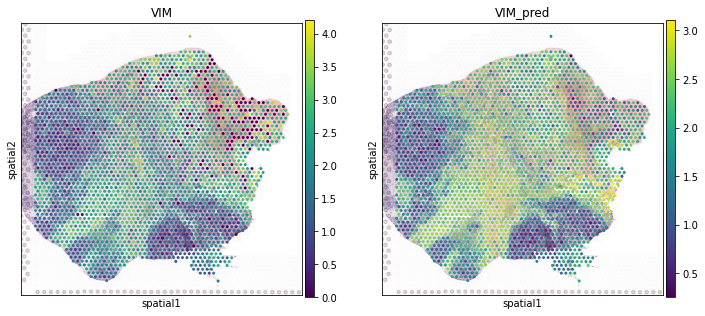

In [82]:
x_hat_df =pd.DataFrame(x_hat_all.cpu().detach().numpy())
x_hat_df.columns = dt.columns
x_hat_df
adA.obs['VIM_pred'] = x_hat_df['VIM'].values
sc.pl.spatial(adA,img_key="hires",color=['VIM','VIM_pred'])

In [83]:
## cor BN with GSVA
# cor based on all spots


#ttt = pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], gsva_scores1.loc[arch_spots,:]], axis=1)#pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)].sum(axis=1)/dt.shape[0]], axis=1)#pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], exp_mat[exp_mat.columns.intersection(gs)].sum(axis=1)], axis=1)#pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)].sum(axis=1)], axis=1)#pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)].sum(axis=1)/dt.shape[0]], axis=1)
    
#tt = ttt.corr()
#x_encoded,x_sample_cell,x_hat_all,x_samp_hat,z_all,z_samp,mu_all,std_all,mu_samp,std_samp
bn_all_np = mu_all.cpu().detach().numpy()
#bn_all_np = mu_all.cpu().detach().numpy()
#bn_all_np = z_all.cpu().detach().numpy()
bn_df = pd.DataFrame(bn_all_np)
bn_df.columns = ['bn'+str(i+1) for i in bn_df.columns]

bn_df.index = gsva_scores1.index

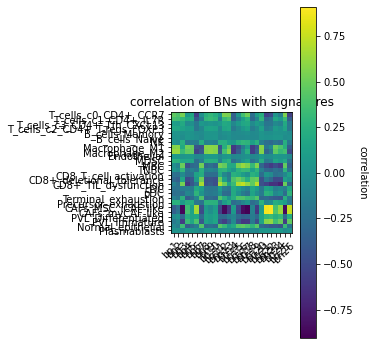

In [84]:
df1 = bn_df#.loc[arch_spots,:]
df2 = gsva_scores1[cells]#.loc[bn_df.index,:]
df=pd.concat([df1, df2], axis=1, keys=['df1', 'df2']).corr().loc['df2', 'df1']

fig, ax = plt.subplots()
#cor_bn_ct_df_marks_n = cor_bn_ct_df_marks.dropna(axis='columns')
#im = ax.imshow(df.divide(df.max(axis=1), axis=0),cmap="PuOr")#/df.max(axis=0),#/cor_bn_ct_df_marks_n.max(axis=0),
               
im = ax.imshow(df,cmap="viridis")

cbar = ax.figure.colorbar(im, ax=ax)#, **cbar_kw
cbar.ax.set_ylabel('correlation', rotation=-90, va="bottom")

# We want to show all ticks...
ax.set_xticks(np.arange(len(df.columns)))
ax.set_yticks(np.arange(len(df.index)))
# ... and label them with the respective list entries
ax.set_xticklabels(df.columns)
ax.set_yticklabels(df.index)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

plt.rcParams["figure.figsize"] = (16, 16)

ax.set_title("correlation of BNs with signatures")
fig.tight_layout()
plt.show()

(2454, 26)


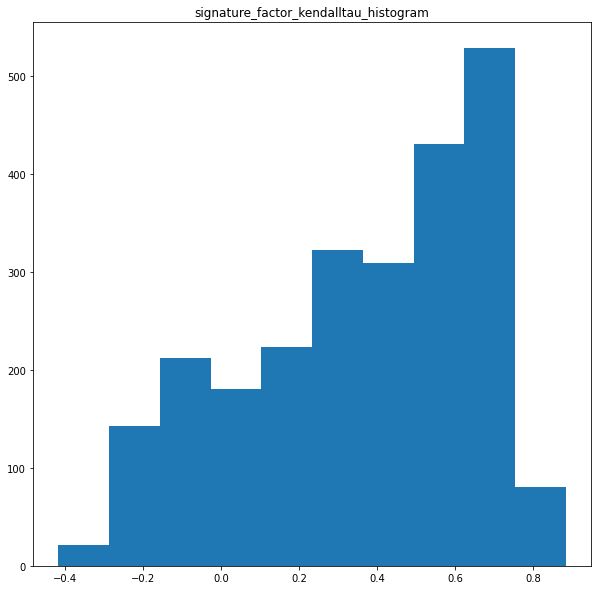

In [85]:
from scipy import stats

mean_ct_signature = []# shape:n_pseudospots X len(gsva_scores1.columns)
#tt = adA.obs
#ttt = np.array(tt['arches_nn_ct'].unique())
#x[~numpy.isnan(x)]
for i in cells:#gsva_scores1.columns:#cell_dic_plot.keys():#valid_cell_dic_ct.keys():#ttt[~np.isnan(ttt)]:#cell_dic_plot.keys():
    
    #mask = tt['arches_nn_ct']==i
    #spots = tt.loc[mask].index.values#adA.obs.loc[:,dA.obs.loc['arches_nn']].index.values()# df1.loc[:, df1.loc['a'] > 0]
    genes_sele = cell_dic_plot[i]
    mean_n = dt[dt.columns.intersection(genes_sele)].sum(axis=1)/len(dt.columns.intersection(genes_sele))
    #dt.loc[arch_nn_spots_ct][dt.columns.intersection(genes_sele)].sum(axis=1)/len(dt.columns.intersection(genes))#dt.loc[spots][dt.columns.intersection(genes_sele)].sum(axis=1)/len(dt.columns.intersection(genes))
    # dt[dt.columns.intersection(genes)].sum(axis=1)/len(dt.columns.intersection(genes))
    mean_ct_signature.append(mean_n)#np.append(mean_arch_ct,mean_n)
    
mean_ct_signature = np.array(mean_ct_signature).T
print(mean_ct_signature.shape)

plt.rcParams["figure.figsize"] = (10, 10)

sig_bn_tau_list = []
sig_bn_pv_list = []
for i in range(gsva_scores1.shape[0]):
    
    tau, p_value = stats.kendalltau(mean_ct_signature[i], bn_df.iloc[i])
    sig_bn_tau_list.append(tau)
    sig_bn_pv_list.append(p_value)
       
plt.hist(sig_bn_tau_list)#, bins = [0,20,40,60,80,100]) 
plt.title("signature_factor_kendalltau_histogram") 
plt.show()

In [93]:
cells

array(['T_cells_c0_CD4+_CCR7', 'T_cells_c1_CD4+_IL7R',
       'T_cells_c3_CD4+_Tfh_CXCL13', 'T_cells_c2_CD4+_T-regs_FOXP3',
       'B_cells_Memory', 'B_cells_Naive', 'NK', 'Macrophage_M1',
       'Macrophage_M2', 'Endothelial', 'MDSC', 'MBC', 'TNBC',
       'CD8_T_cell_activation', 'CD8+_deletional_tolerance',
       'CD8+_TIL_dysfunction', 'cDC', 'pDC', 'Terminal_exhaustion',
       'Precursor_exhaustion', 'CAFs_MSC_iCAF-like', 'CAFs_myCAF-like',
       'PVL_Differentiated', 'PVL_Immature', 'Normal_epithelial',
       'Plasmablasts'], dtype=object)

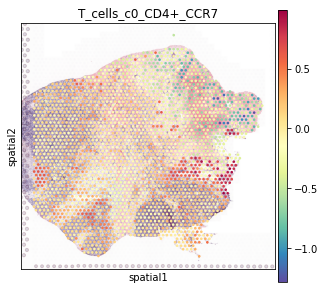

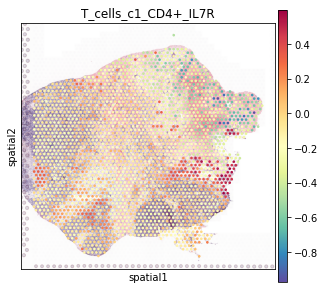

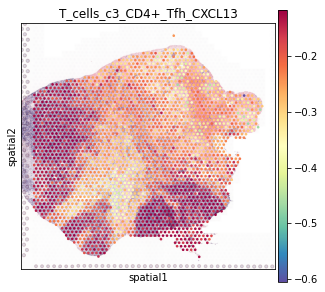

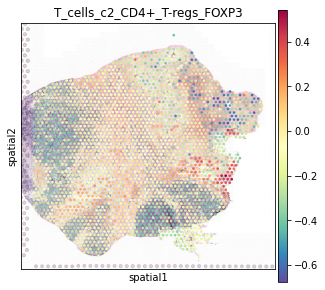

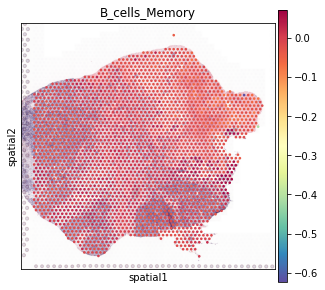

...

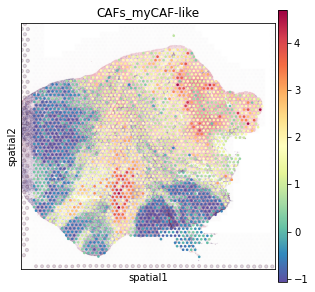

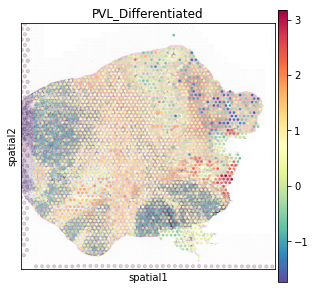

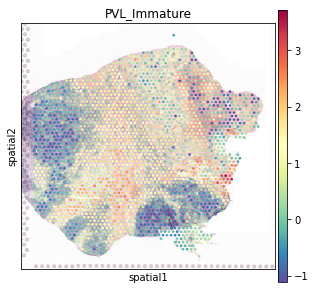

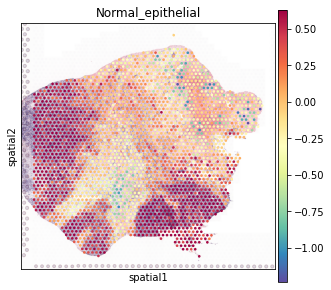

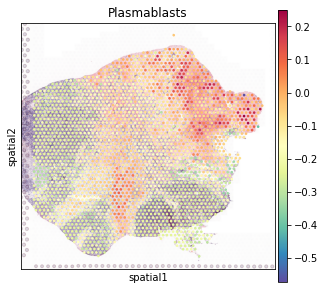

In [87]:
keys = ['bn1', 'bn2','bn3','bn4','bn5', 'bn6','bn7','bn8','bn9',
                       'bn10','bn11','bn12','bn13','bn14','bn15',
                       'bn16','bn17','bn18', 'bn19','bn20',
                       'bn21','bn22','bn23','bn24','bn25',
                       'bn26']
ct_dict = dict(zip(keys,cells))


plt.rcParams["figure.figsize"] = (5, 5)
for ii in bn_df.columns:
        adA.obs[ii] = bn_df[ii].values
        sc.pl.spatial(
        adA,
        img_key="hires",
        title=ct_dict[ii],
        color=ii,cmap='Spectral_r'#'cividis'
        
    )



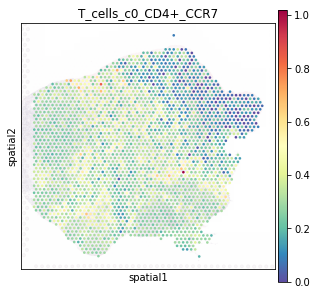

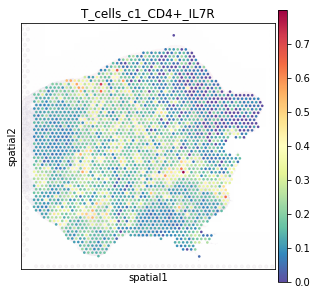

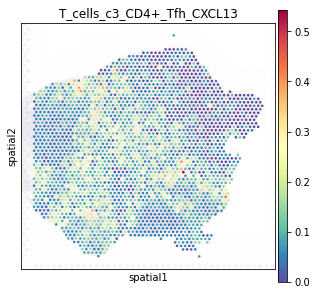

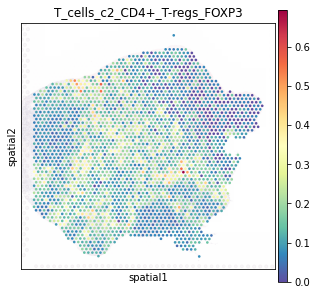

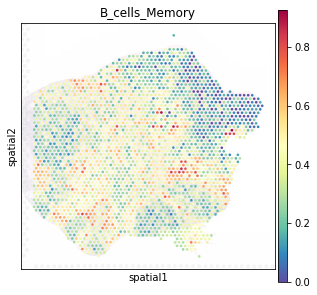

...

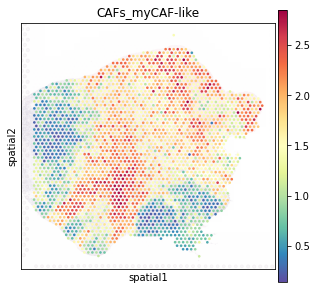

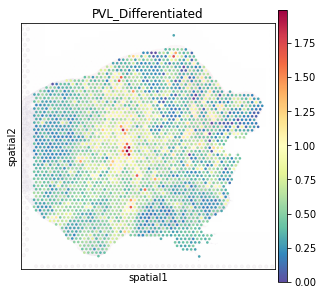

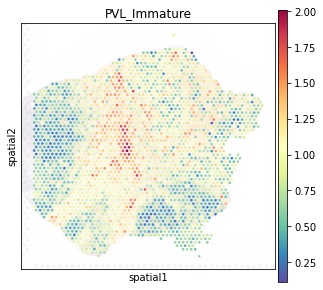

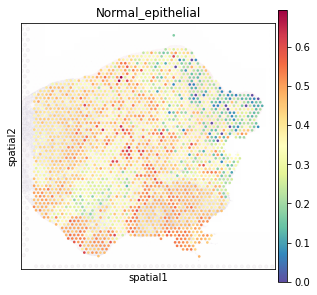

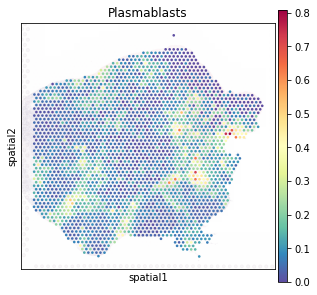

In [88]:
for ii in cell_dic_plot.keys():
    genes = cell_dic_plot[ii]
    adA.obs[ii] = dt[dt.columns.intersection(genes)].sum(axis=1)/len(dt.columns.intersection(genes))
    sc.pl.spatial(adA,img_key="hires",color_map='Spectral_r',color=ii,alpha_img=0.2)





In [89]:
tmp = exp_df_B[dt.columns]
tmp.index.name = 'cell_id'#tmp.index.name = 'cell_id'
#print(tmp.shape)
#len(tmp.columns[tmp.isna().any()].tolist())
tmp = tmp.fillna(0)

genes_sele = np.append(adA.var.loc[adA.var['highly_variable'] == True].index.values,marker_genes)
dt_test = tmp[tmp.columns.intersection(genes_sele)]




#tmp = tmp.loc[:,~tmp.columns.duplicated()]
#tmp

#genes_sele = np.append(adA.var.loc[adata.var['highly_variable'] == True].index.values,marker_genes)
#dt_test = np.log1p(tmp[tmp.columns.intersection(genes_sele)])
print(dt_test.shape)



#xx = dt.loc[[emptyDict[k] for k in list(valid_cell_dic.keys()) ]]
#dt = tmp[tmp.columns.intersection(ad1.var.loc[ad1.var['highly_variable'] == True].index.values)]
vd_test = visiumDataset(exp_mat=dt_test)#visiumDataset(exp_mat=xx.loc[xx.index.repeat(100)])#visiumDataset(exp_mat=dt)#visiumDataset(exp_mat=xx.loc[xx.index.repeat(10)])#visiumDataset(exp_mat=dt)#visiumDataset(exp_mat=dt)


testdata_loader = torch.utils.data.DataLoader(
                 dataset=vd_test,#dataset=train_set,
                 batch_size=len(vd_test),
                 #shuffle=True,
                 num_workers=8,
                 #prefetch_factor=64,
)


for batch_idx,testdata in enumerate(testdata_loader):
    print(batch_idx,testdata.size()) 
    #x_encoded,x_sample_cell,x_hat,x_samp_hat,z,z_samp,mu,std,mu_samp,std_samp
    x_encoded_test,x_sample_cell,x_hat_test,x_samp_hat,z_test,z_samp,mu_test,std_test,mu_samp,std_samp = vae_gpu(testdata,sample_signatures_r) #vae_gpu(alldata.cuda(),sample_signatures_r) 
    
bn_test_np = mu_test.cpu().detach().numpy()
#bn_all_np = mu_all.cpu().detach().numpy()
#bn_all_np = z_all.cpu().detach().numpy()
bn_df_test = pd.DataFrame(bn_test_np)
bn_df_test.columns = ['bn'+str(i+1) for i in bn_df_test.columns]

(2551, 5406)
0 torch.Size([2551, 5406])


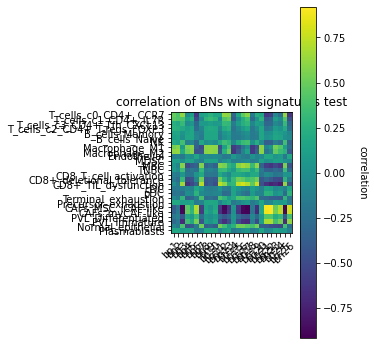

In [90]:
gsva_scores_test = pd.read_csv('signature_v5_res/markers_gsva_1B_individual_mod.csv',index_col=0)

bn_df_test.index = gsva_scores_test.index

#gsva_scores_test = gsva_scores_test.drop(columns=['Basal_SC', 'BC','Fibroblast','Her2E_SC','LumA_SC','LumB_SC','MCB2','TNBC'])

df1 = bn_df_test#.loc[arch_spots,:]
df2 = gsva_scores_test[cells]#.loc[bn_df.index,:]
df2.index = df1.index
df=pd.concat([df1, df2], axis=1, keys=['df1', 'df2']).corr().loc['df2', 'df1']

fig, ax = plt.subplots()
#cor_bn_ct_df_marks_n = cor_bn_ct_df_marks.dropna(axis='columns')
#im = ax.imshow(df.divide(df.max(axis=1), axis=0),cmap="PuOr")#/df.max(axis=0),#/cor_bn_ct_df_marks_n.max(axis=0),
               

im = ax.imshow(df,cmap="viridis")

cbar = ax.figure.colorbar(im, ax=ax)#, **cbar_kw
cbar.ax.set_ylabel('correlation', rotation=-90, va="bottom")

# We want to show all ticks...
ax.set_xticks(np.arange(len(df.columns)))
ax.set_yticks(np.arange(len(df.index)))
# ... and label them with the respective list entries
ax.set_xticklabels(df.columns)
ax.set_yticklabels(df.index)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

#plt.rcParams["figure.figsize"] = (8, 8)

ax.set_title("correlation of BNs with signatures test")
fig.tight_layout()
plt.show()

In [92]:
bn_df.to_csv('signature_v5_res/bn_df_1A_individual.csv')#bn_df.to_csv('signature_v2_res/bn_df_1A_n.csv')

bn_df_test.to_csv('signature_v5_res/bn_df_1B_individual.csv')

In [ ]:
from scipy.stats import wasserstein_distance
w_dists = []
for i in bn_df_test.columns:
    w_dists = np.append(w_dists,wasserstein_distance(bn_df_test[i], bn_df[i]))
    
w_dists

wass_dist = np.empty((0,3244), float)
for i in range(A.shape[0]):
    tmp = []
    for j in range(B.shape[0]):
        tmp = np.append(tmp,wasserstein_distance(A[i,], B[j,]))
    #wass_dist=np.append(wass_dist,tmp, axis=0)
    wass_dist= np.vstack([wass_dist, tmp])

 

In [ ]:
iscc_lr_res = pd.read_csv('~/Downloads/bc_visium_mod/signature_v3_res/iscc_lr_res_1A.csv',index_col=0)
iscc_lr_res.sort_values(by='score', ascending=False)

iscc_lr_res_n = iscc_lr_res[iscc_lr_res['score'] > 0.3]
iscc_lr_res_n.sort_values(by='score', ascending=False)

In [ ]:
for ii in bn_df.columns:
        adA.obs[ct_dict[ii]] = bn_df[ii].values

#import matplotlib.backends.backend_pdf
#from matplotlib.backends.backend_pdf import PdfPages
#pdf = matplotlib.backends.backend_pdf.PdfPages("/Users/xueerchen/Downloads/bc_visium_mod/signature_v3_res/isci_output_plot.pdf")

#with PdfPages("/Users/xueerchen/Downloads/bc_visium_mod/signature_v3_res/isci_output_plot.pdf") as pdf:

for j in iscc_lr_res_n.index:
# filter with spot-wise correlation of bns and lrs
# maybe use inferred gexp

    li = iscc_lr_res_n.loc[j,'ligand']
    re = iscc_lr_res_n.loc[j,'receptor']

    if li in x_hat_df.columns and re in x_hat_df.columns:
        adA.obs[li+'_r'] = x_hat_df[li].values
        adA.obs[re+'_r'] = x_hat_df[re].values
        #fig = plt.figure()
        sc.pl.spatial(adA,img_key="hires",alpha_img=0.2,color=[iscc_lr_res_n.loc[j,'f1'],iscc_lr_res_n.loc[j,'f2'],li+'_r',re+'_r'],cmap='Spectral_r',return_fig=True)
        #pdf.savefig(fig)


#pdf.close()

... storing 'biclust' as categorical


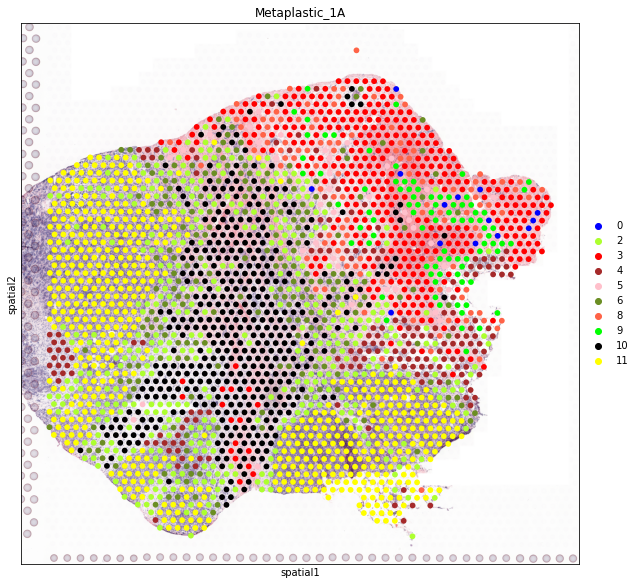

In [94]:
biclust_r = pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/bn_alltumors_bicluster_res_row_orders_no_norm.csv',index_col=0)
biclust_r.index = biclust_r.id
plt.rcParams["figure.figsize"] = (10, 10)

biclust = []
for i in adA.obs.index+'_1A':
    if i in biclust_r.index:
        biclust = np.append(biclust,biclust_r.loc[i,'cluster'].astype(str))
    else:
        biclust = np.append(biclust,'na')
        
adA.obs['biclust'] = biclust#biclust_r.loc[adata.obs.index,'cluster'].astype(str)
sc.pl.spatial(adA,img_key="hires",color='biclust',title='Metaplastic_1A',palette={'0':'blue','1':'orange','2':'greenyellow','3':'red','4':'brown','5':'pink','6':'olivedrab','7':'cyan','8':'tomato','9':'lime','10':'black','11':'yellow'})

In [96]:
exp_df.index = exp_df.index+'_1A'



In [101]:
irgs = pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/immune_genes_bc.csv',header=None)



In [97]:
# calculate by average within each hub
## not real distance (use order as distance)
from scipy.spatial import distance
from sklearn.linear_model import LinearRegression
from scipy.stats import pearsonr
from sklearn.cluster import KMeans
import sklearn.cluster


pos_df = pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/data/V1_Breast_Cancer_Block_A_Section_1/spatial/tissue_positions_list.csv',header=None)
pos_df.index = pos_df[0]+'_1A'
# append centers of each hub
# later use tumor center(s) as start point and automatically rank other hubs (by distance from tumor centers), then calculate mean expression of genes in each hub, 
#calculate (ave) gene regress on distance
# use cl label to calculate average gene expression

x_hat_df.index = exp_df.index

hub_centers = np.empty((0,2))
irg_ave = np.empty((0,x_hat_df.shape[1]))
hub_labels = []
#'0',  '2',  '3',  '4',  '5', '7',  '8', '10'
for i in ['0', '2',  '3', '4','5', '6','8','9', '10']:#['0', '3',  '4',  '5', '7',  '9', '10']:#np.unique(adA.obs['biclust']):#range(0,10):
    ds = biclust_r['cluster']
    mask = ds == int(i)
    cl_spots = np.intersect1d(pos_df.index,ds.loc[mask].index)
    
    df_clust = pd.DataFrame({'x':pos_df.loc[cl_spots,4],'y':pos_df.loc[cl_spots,5]})
    kmeans_cl = sklearn.cluster.KMeans(n_clusters=2).fit(df_clust)
    hub_centers = np.append(hub_centers,kmeans_cl.cluster_centers_,axis=0)
    
    # for each hub, calculate average gxp
    df = x_hat_df.loc[cl_spots]
    df['cl'] = kmeans_cl.labels_
    grouped_df = df.groupby("cl")
    mean_df = grouped_df.mean()
    irg_ave = np.append(irg_ave,mean_df,axis=0)
    
    hub_labels = np.append(hub_labels,[i,i])


#hub_centers
print(irg_ave.shape,hub_centers.shape,len(hub_labels))

i = '11'
ds = biclust_r['cluster']
mask = ds == int(i)
cl_spots = np.intersect1d(pos_df.index,ds.loc[mask].index)



df_clust = pd.DataFrame({'x':pos_df.loc[cl_spots,4],'y':pos_df.loc[cl_spots,5]})
kmeans_cl= sklearn.cluster.KMeans(n_clusters=3).fit(df_clust)
hub_center_tumor = kmeans_cl.cluster_centers_
# for each hub, calculate average gxp
df = x_hat_df.loc[cl_spots]
df['cl'] = kmeans_cl.labels_
grouped_df = df.groupby("cl")
mean_df_tumor = grouped_df.mean()

(18, 5406) (18, 2) 18


0.1624858583013217
0.9430377830688901
          gene      coef     score       cor
3502     SHMT2 -0.015410  0.921631 -0.960016
4155     KCTD5 -0.006983  0.920476 -0.959414
3810     EXOC5 -0.006724  0.919322 -0.958813
4782       ID1 -0.029406  0.912814 -0.955413
1332      RFC1 -0.007571  0.912164 -0.955073
3922      BRF1 -0.007717  0.902912 -0.950217
1739    SKIV2L -0.015441  0.900219 -0.948799
4783    COX4I2 -0.015694  0.893956 -0.945493
1832    UBE2J1 -0.011327  0.893128 -0.945054
4929      DNM2 -0.032838  0.891286 -0.944080
4690    RALBP1 -0.018272  0.889712 -0.943245
3755     CDH24 -0.003431  0.887322 -0.941978
2093     GNG11 -0.066082  0.886418 -0.941498
3370     SPSB2 -0.006093  0.884788 -0.940632
1765     FKBP5 -0.009025  0.882601 -0.939468
3232    SPOCK2 -0.010625  0.881813 -0.939049
865     CALCRL -0.020274  0.881357 -0.938806
3669      RGCC -0.031317  0.881098 -0.938668
5270     PDGFB -0.018879  0.879902 -0.938031
1309    BOD1L1 -0.008288  0.879827 -0.937991
2310     ITM2A -0

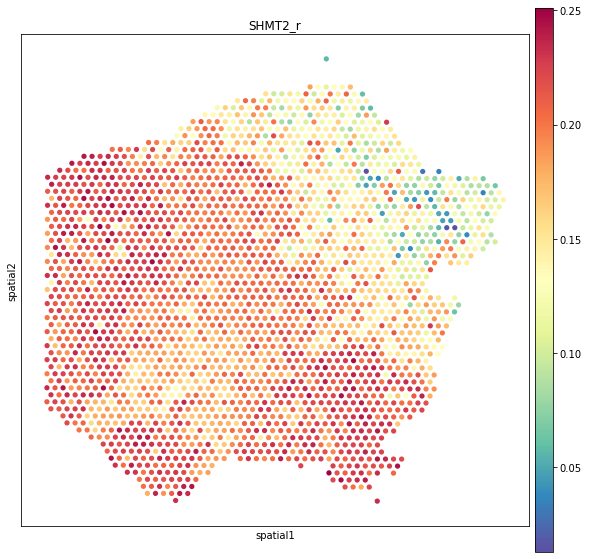

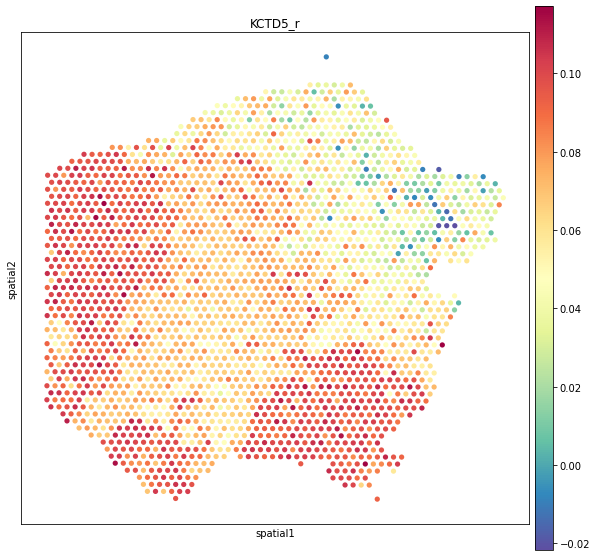

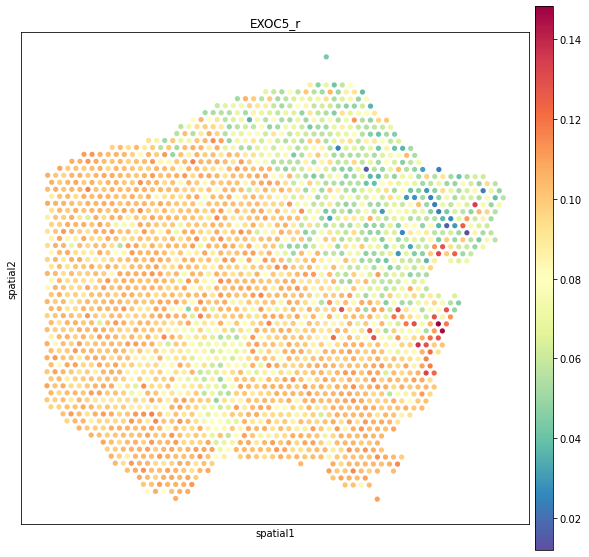

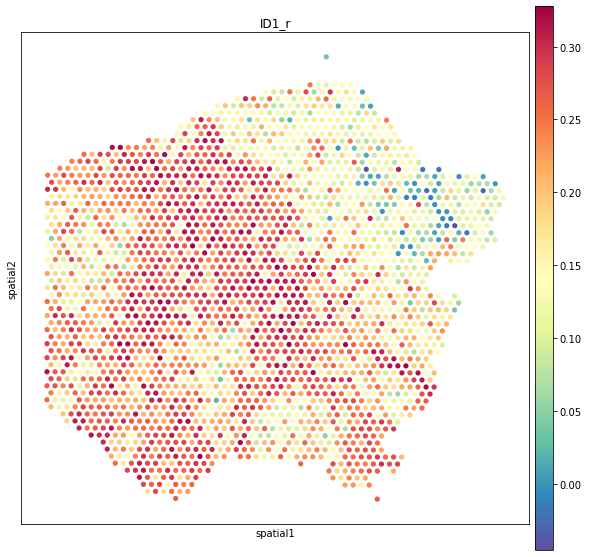

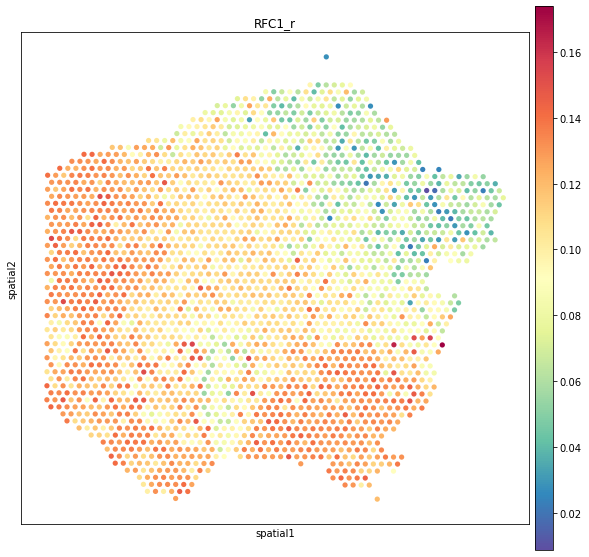

...

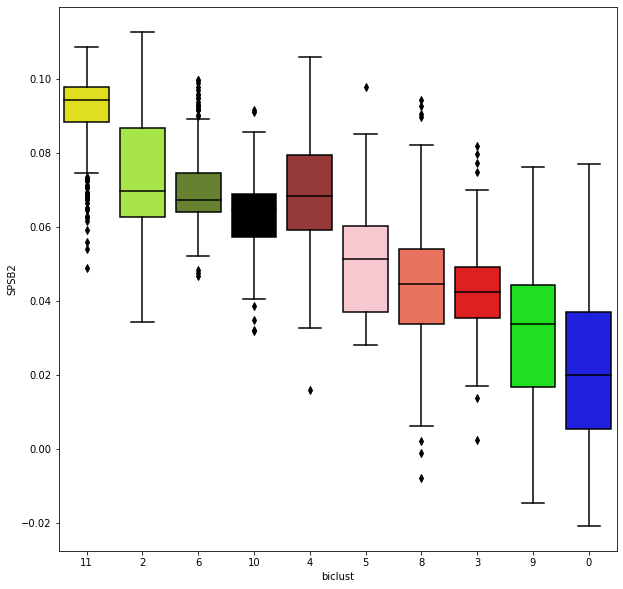

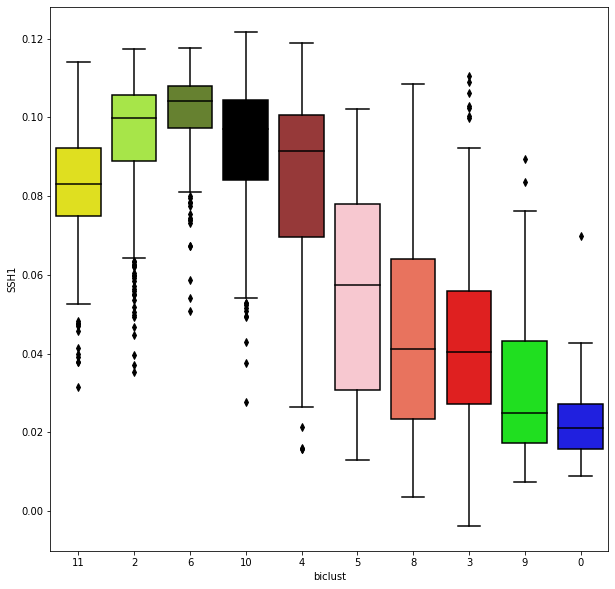

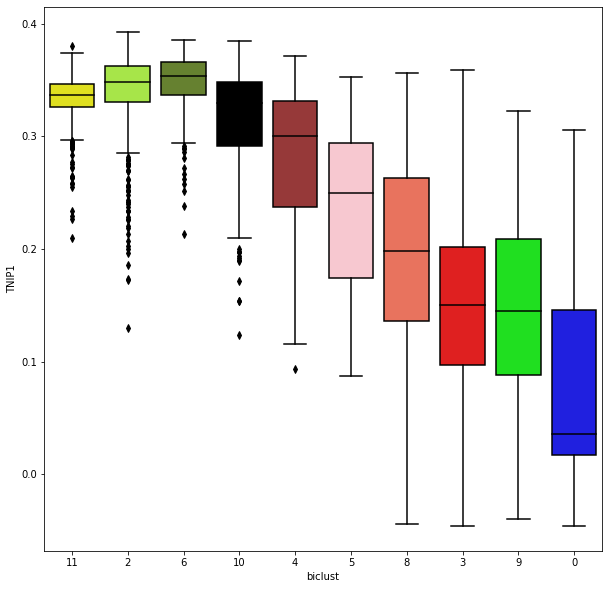

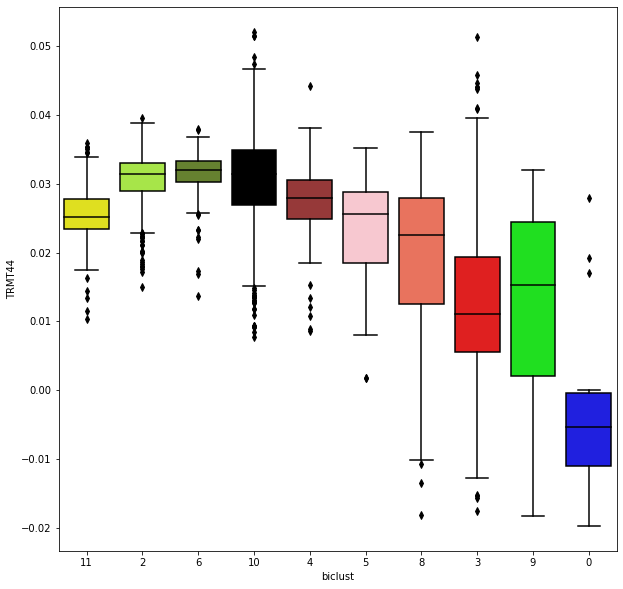

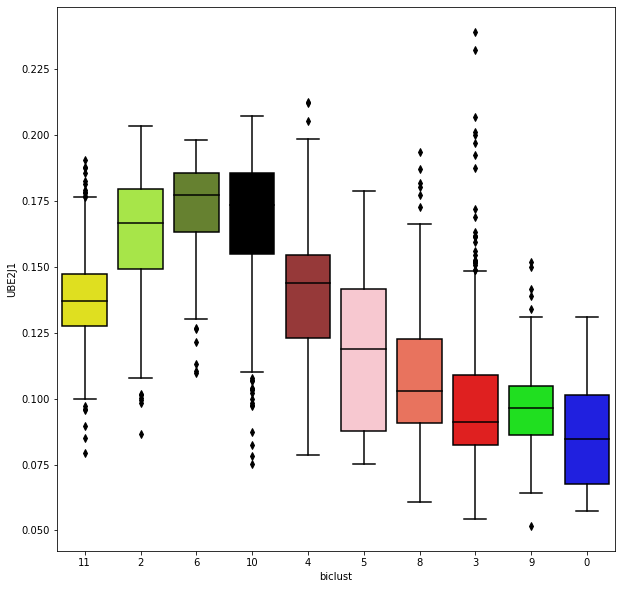

In [114]:
# ave version
#'0', '1', '2',  '3', '5', '6','7','9', '10'
dist_dic = dict({'11':1,'2':2, '6':3,'10':4,  '4':5,  '5':6, '8':7,  '3':8,'9':9, '0':10})
dist_n =  np.repeat([dist_dic[i] for i in hub_labels], 3, axis=0).reshape(len(hub_labels), 3)#np.empty((0,2)) #[dist_dic[i] for i in hub_labels]
#to_append = np. array([1, 2, 3])
#combined_array = np. append(empty_array, to_append) append `to_append` to `empty_array`#distance.cdist(hub_centers, hub_center_tumor, 'euclidean')
#print(dist.shape)

dist_df_n = pd.DataFrame(dist_n)
dist_df_n.index = hub_labels
dist_df_n.columns = ['tumor_hub1','tumor_hub2','tumor_hub3']
dist_df_n.sort_values(by=['tumor_hub1'])

#################

########################

irg_ave_df = pd.DataFrame(irg_ave)
irg_ave_df.index = hub_labels
irg_ave_df.columns = dt.columns

coefs_a=[]
cors_a=[]
scores_a = []
genes_a = []
for i in dt.columns:#np.intersect1d(irgs[0],dt.columns):#dt.columns:#np.intersect1d(irgs[0],dt.columns):#
    
    reg = LinearRegression().fit(np.array(dist_n[:,0]).reshape(-1, 1),np.array(irg_ave_df[i]).reshape(-1, 1))
    coefs_a = np.append(coefs_a,reg.coef_)
    scores_a = np.append(scores_a,reg.score(np.array(dist_n[:,0]).reshape(-1, 1),np.array(irg_ave_df[i]).reshape(-1, 1)))
    corr, _ = pearsonr(np.array(dist_n[:,0]),np.array(irg_ave_df[i]))
    cors_a = np.append(cors_a,corr)
    genes_a = np.append(genes_a,i)
    
print(np.max(coefs_a))
print(np.max(cors_a[~(np.isnan(cors_a))]))
#-np.sort(-cors)
irg_rnk_a = pd.DataFrame({'gene':genes_a,'coef':coefs_a,'score':scores_a,'cor':cors_a})
irg_rnk_a.to_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/tumor_hub_gradient_hvgs_1A.csv')
    
irg_rnk_a[['gene','cor']].to_csv('signature_v5_res/tumor_hub_gradient_hvgs_gene_1A.rnk', header=None, index=None, sep='\t')

print(irg_rnk_a.sort_values(by=['cor'],ascending=True).head(50))
print(irg_rnk_a.sort_values(by=['coef'],ascending=True).head(15))
print(irg_rnk_a.sort_values(by=['score'],ascending=True).head(15))

plt.rcParams["figure.figsize"] = (10, 10)


x_hat_df.index= adA.obs.index
for g in np.array(irg_rnk_a.sort_values(by=['cor'],ascending=True)['gene'][0:10]):
    adA.obs[g+'_r'] = x_hat_df[g]
    sc.pl.spatial(
        adA,alpha_img=0,
        img_key="hires",
        
        color=g+'_r',color_map='Spectral_r')#,color_map=reds
    
glist = np.array(irg_rnk_a.sort_values(by=['cor'],ascending=True)['gene'][0:30])#sc.get.rank_genes_groups_df(adA, group=i, key='hub_deg')['names'].squeeze().str.strip().tolist()
#print(len(glist))

for ii,i in enumerate(np.intersect1d(glist,x_hat_df.columns)):
    
    
    my_pal = {'0':'blue','1':'orange','2':'greenyellow','3':'red','4':'brown','5':'pink','6':'olivedrab','7':'cyan','8':'tomato','9':'lime','10':'black','11':'yellow'}
    plt.figure(ii)
    sns.boxplot(x = adA.obs['biclust'],
            y = x_hat_df[i],#adA.obs[i],
            order=['11','2', '6','10',  '4',  '5', '8',  '3','9', '0'],palette=my_pal)
    

(18, 5406) (18, 2) 18
(18, 3)
8.066461163344246e-05
0.767461956413136
         gene          coef     score       cor
318     REPS1 -3.227091e-06  0.719774 -0.848395
247       LTA -2.387268e-06  0.707394 -0.841067
186     IFI27 -1.026958e-04  0.706383 -0.840466
17       ATG5 -7.368918e-06  0.703837 -0.838950
163    FLT3LG -9.925472e-06  0.702371 -0.838076
119    CXCL13 -2.774897e-06  0.690243 -0.830809
132     DUSP4 -8.191728e-06  0.688402 -0.829700
359  TNFRSF18 -5.264109e-06  0.680593 -0.824981
115    CX3CR1 -5.418827e-06  0.674948 -0.821552
228     ITGB1 -6.101469e-05  0.653393 -0.808327
280    NFATC3 -6.497802e-06  0.641166 -0.800729
310   PRPF38A -9.432596e-06  0.636316 -0.797694
116    CXCL10 -3.350258e-05  0.630283 -0.793904
206     IL2RA -1.508119e-06  0.629553 -0.793444
85        CD7 -8.098159e-06  0.625649 -0.790980
194     IKBKG -4.099722e-06  0.624802 -0.790444
222     ITGA1 -2.383251e-05  0.620827 -0.787926
238      LAG3 -1.018242e-05  0.615196 -0.784345
166     FOXP3 -7.4

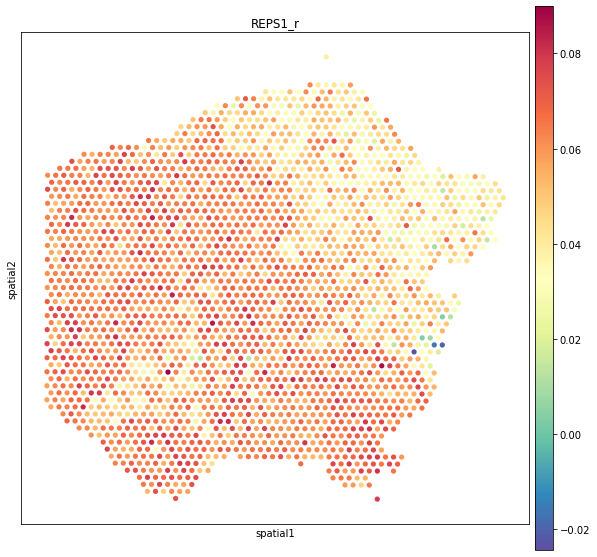

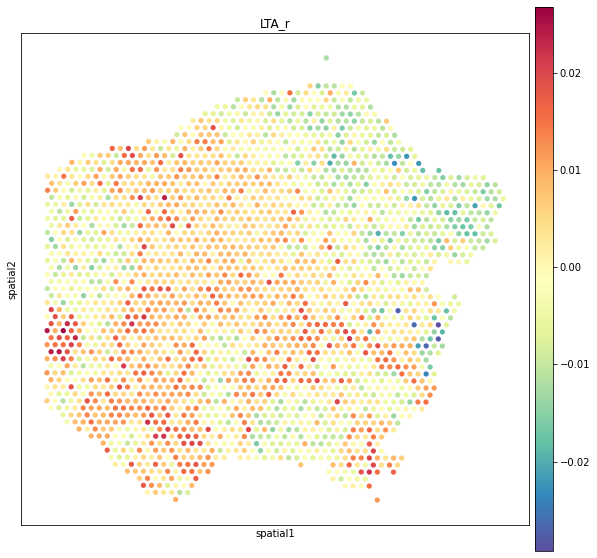

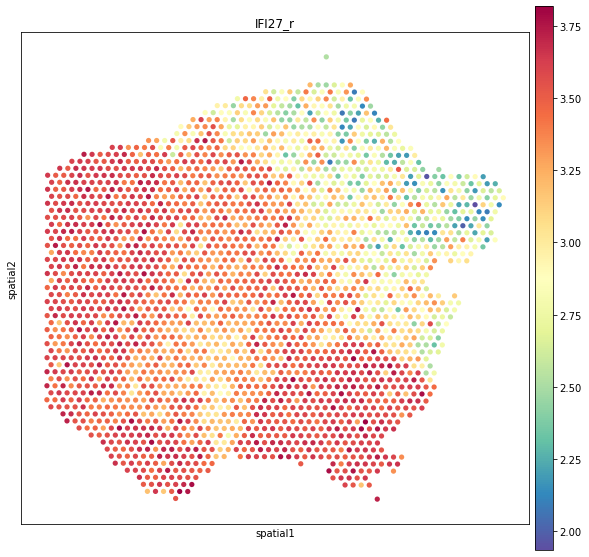

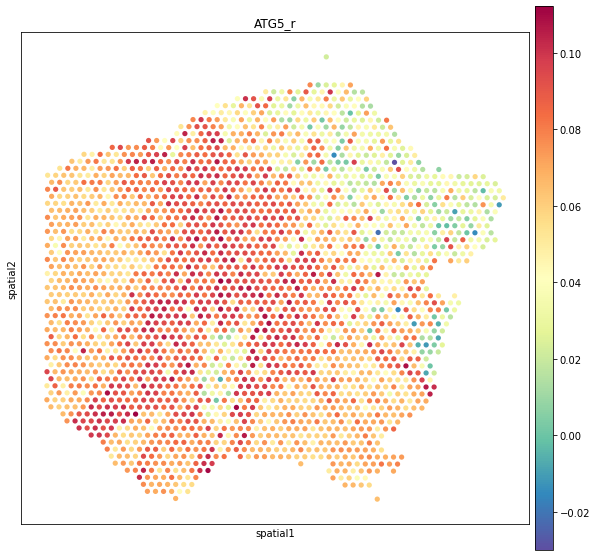

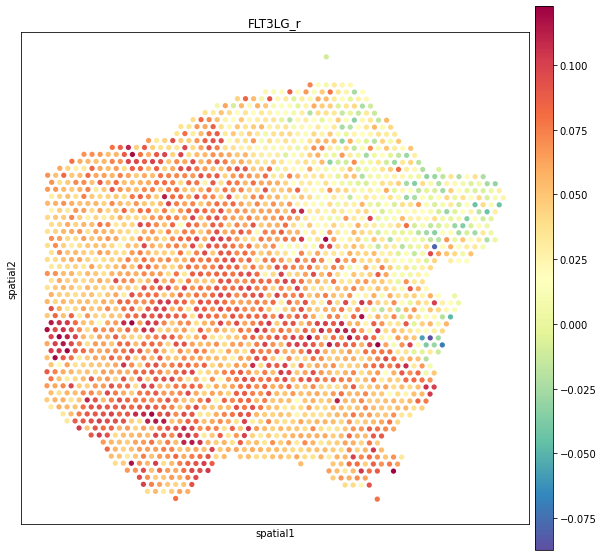

...

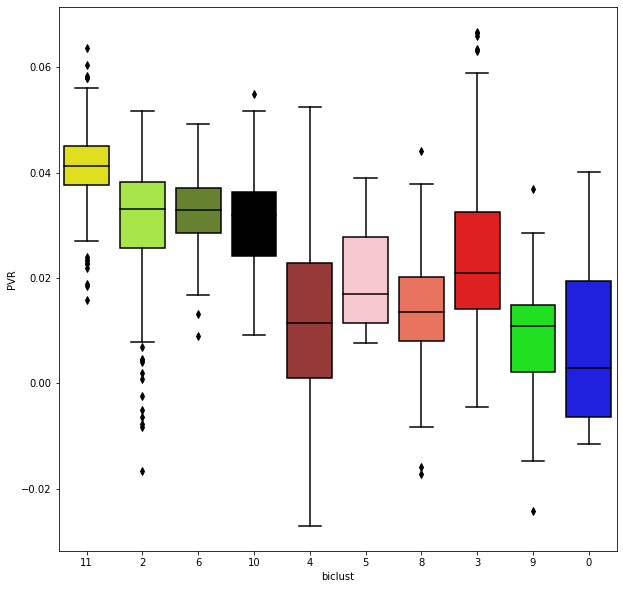

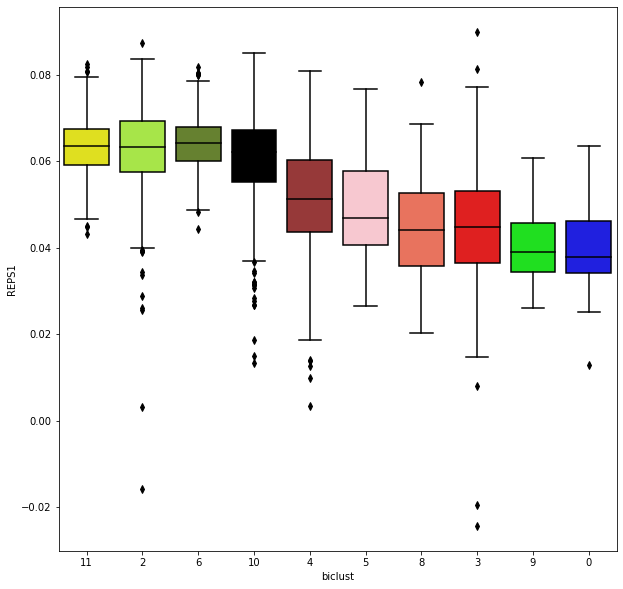

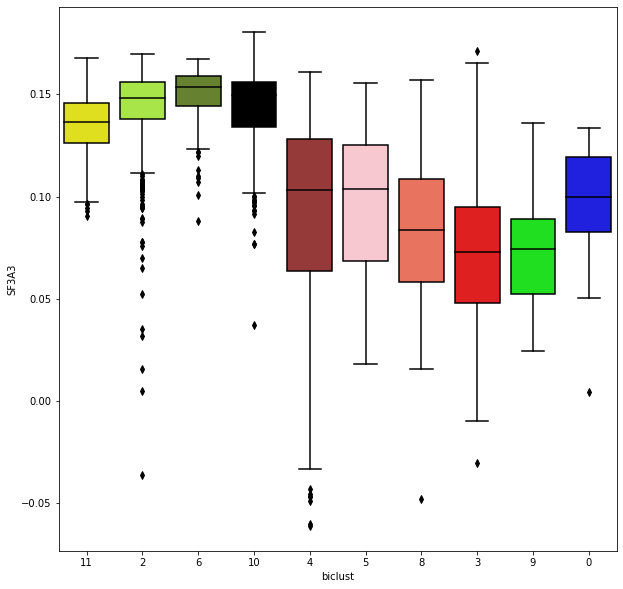

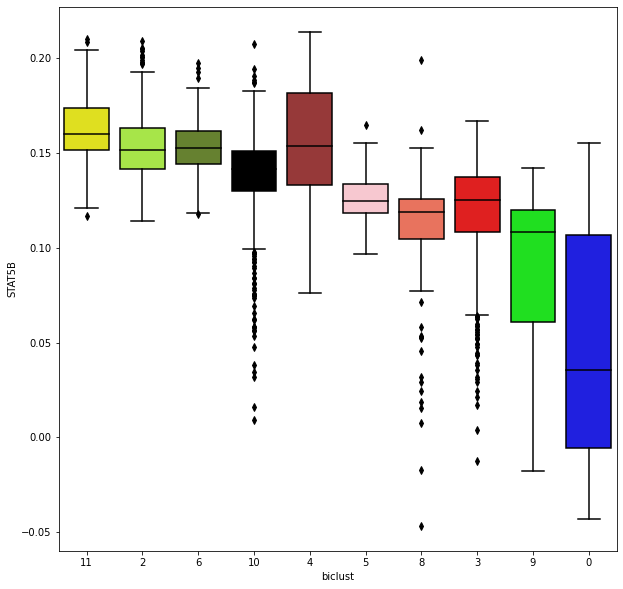

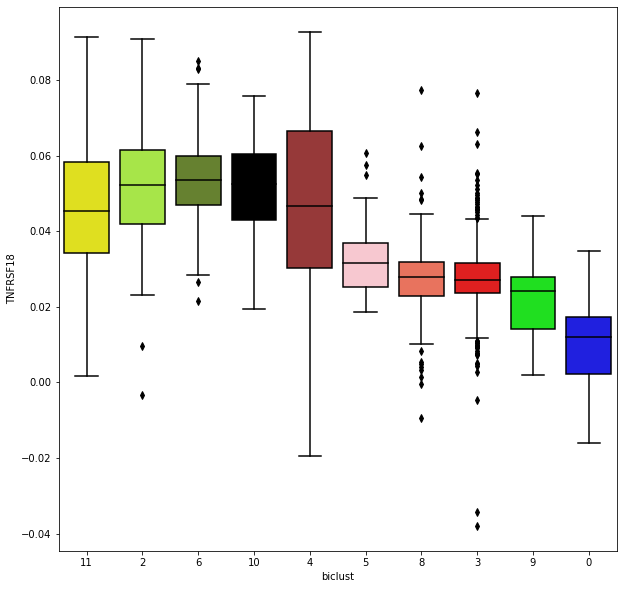

In [115]:
x_hat_df.index = exp_df.index#x_hat_df.index+'_1A'
# calculate by average within each hub
pos_df = pd.read_csv('/Users/xueerchen/Downloads/bc_visium_mod/data/V1_Breast_Cancer_Block_A_Section_1/spatial/tissue_positions_list.csv',header=None)
pos_df.index = pos_df[0]+'_1A'
# append centers of each hub
# later use tumor center(s) as start point and automatically rank other hubs (by distance from tumor centers), then calculate mean expression of genes in each hub, 
#calculate (ave) gene regress on distance
# use cl label to calculate average gene expression

hub_centers = np.empty((0,2))
irg_ave = np.empty((0,x_hat_df.shape[1]))
hub_labels = []
for i in ['0', '2',  '3', '4','5', '6','8','9', '10']:#np.unique(adA.obs['biclust']):#range(0,10):
    ds = biclust_r['cluster']
    mask = ds == int(i)
    cl_spots = np.intersect1d(pos_df.index,ds.loc[mask].index)
    
    df_clust = pd.DataFrame({'x':pos_df.loc[cl_spots,4],'y':pos_df.loc[cl_spots,5]})
    kmeans_cl = sklearn.cluster.KMeans(n_clusters=2).fit(df_clust)
    hub_centers = np.append(hub_centers,kmeans_cl.cluster_centers_,axis=0)
    
    # for each hub, calculate average gxp
    df = x_hat_df.loc[cl_spots]
    df['cl'] = kmeans_cl.labels_
    grouped_df = df.groupby("cl")
    mean_df = grouped_df.mean()
    irg_ave = np.append(irg_ave,mean_df,axis=0)
    
    hub_labels = np.append(hub_labels,[i,i])


#hub_centers
print(irg_ave.shape,hub_centers.shape,len(hub_labels))

i = '11'
ds = biclust_r['cluster']
mask = ds == int(i)
cl_spots = np.intersect1d(pos_df.index,ds.loc[mask].index)

df_clust = pd.DataFrame({'x':pos_df.loc[cl_spots,4],'y':pos_df.loc[cl_spots,5]})
kmeans_cl= sklearn.cluster.KMeans(n_clusters=3).fit(df_clust)
hub_center_tumor = kmeans_cl.cluster_centers_
# for each hub, calculate average gxp
df = x_hat_df.loc[cl_spots]
df['cl'] = kmeans_cl.labels_
grouped_df = df.groupby("cl")
mean_df_tumor = grouped_df.mean()

# ave version
dist = distance.cdist(hub_centers, hub_center_tumor, 'euclidean')
print(dist.shape)
dist_df = pd.DataFrame(dist)
dist_df.index = hub_labels
dist_df.columns = ['tumor_hub1','tumor_hub2','tumor_hub3']
dist_df.sort_values(by=['tumor_hub1'])

irg_ave_df = pd.DataFrame(irg_ave)
irg_ave_df.index = hub_labels
irg_ave_df.columns = dt.columns

coefs_a=[]
cors_a=[]
scores_a = []
genes_a = []
for i in np.intersect1d(irgs[0],dt.columns):#dt.columns:#np.intersect1d(irgs[0],dt.columns):#
    
    reg = LinearRegression().fit(np.array(dist[:,0]).reshape(-1, 1),np.array(irg_ave_df[i]).reshape(-1, 1))
    coefs_a = np.append(coefs_a,reg.coef_)
    scores_a = np.append(scores_a,reg.score(np.array(dist[:,0]).reshape(-1, 1),np.array(irg_ave_df[i]).reshape(-1, 1)))
    corr, _ = pearsonr(np.array(dist[:,0]),np.array(irg_ave_df[i]))
    cors_a = np.append(cors_a,corr)
    genes_a = np.append(genes_a,i)
    
print(np.max(coefs_a))
print(np.max(cors_a[~(np.isnan(cors_a))]))
#-np.sort(-cors)
irg_rnk_a = pd.DataFrame({'gene':genes_a,'coef':coefs_a,'score':scores_a,'cor':cors_a})

irg_rnk_a.to_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/tumor_hub_gradient_irgs_1A.csv')
irg_rnk_a[['gene','cor']].to_csv('signature_v5_res/tumor_hub_gradient_irgs_gene_1A.rnk', header=None, index=None, sep='\t')


print(irg_rnk_a.sort_values(by=['cor'],ascending=True).head(50))
print(irg_rnk_a.sort_values(by=['coef'],ascending=True).head(15))
print(irg_rnk_a.sort_values(by=['score'],ascending=True).head(15))

plt.rcParams["figure.figsize"] = (10, 10)


x_hat_df.index= adA.obs.index
for g in np.array(irg_rnk_a.sort_values(by=['cor'],ascending=True)['gene'][0:10]):
    adA.obs[g+'_r'] = x_hat_df[g]
    sc.pl.spatial(
        adA,alpha_img=0,
        img_key="hires",
        
        color=g+'_r',color_map='Spectral_r')#,color_map=reds
    
glist = np.array(irg_rnk_a.sort_values(by=['cor'],ascending=True)['gene'][0:30])#sc.get.rank_genes_groups_df(adA, group=i, key='hub_deg')['names'].squeeze().str.strip().tolist()
#print(len(glist))

for ii,i in enumerate(np.intersect1d(glist,x_hat_df.columns)):
    
    
    my_pal = {'0':'blue','1':'orange','2':'greenyellow','3':'red','4':'brown','5':'pink','6':'olivedrab','7':'cyan','8':'tomato','9':'lime','10':'black','11':'yellow'}
    plt.figure(ii)
    sns.boxplot(x = adA.obs['biclust'],
            y = x_hat_df[i],#adA.obs[i],
            order=['11','2', '6','10',  '4',  '5', '8',  '3','9', '0'],palette=my_pal)
    






<AxesSubplot:xlabel='biclust', ylabel='hub_gradient_genes_irg'>

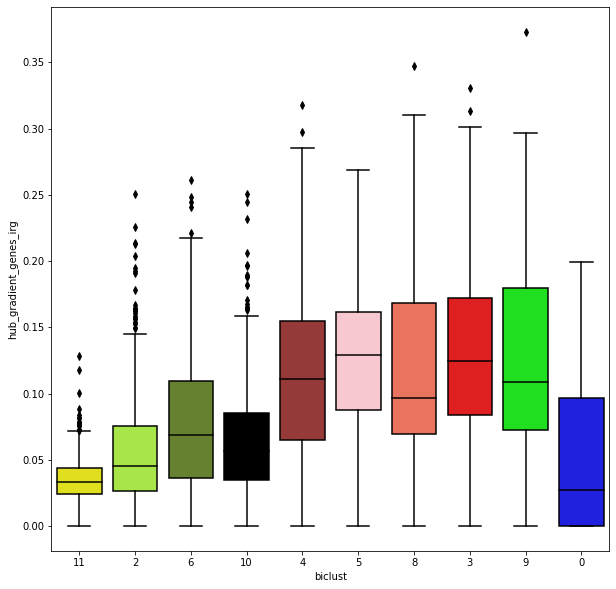

In [108]:
glist_u = np.array(irg_rnk_a.sort_values(by=['cor'],ascending=False)['gene'][0:30])#sc.get.rank_genes_groups_df(adA, group=i, key='hub_deg')['names'].squeeze().str.strip().tolist()

#print(len(glist))
adA.obs['hub_gradient_genes_irg'] = dt[dt.columns.intersection(glist_u)].sum(axis=1)/31

my_pal = {'0':'blue','1':'orange','2':'greenyellow','3':'red','4':'brown','5':'pink','6':'olivedrab','7':'cyan','8':'tomato','9':'lime','10':'black','11':'yellow'}
sns.boxplot(x = adA.obs['biclust'],
        y = adA.obs['hub_gradient_genes_irg'],
        order=['11','2', '6','10',  '4',  '5', '8',  '3','9', '0'],palette=my_pal)#,hue = adA.obs['sex']





<AxesSubplot:xlabel='biclust', ylabel='hub_gradient_genes_irg'>

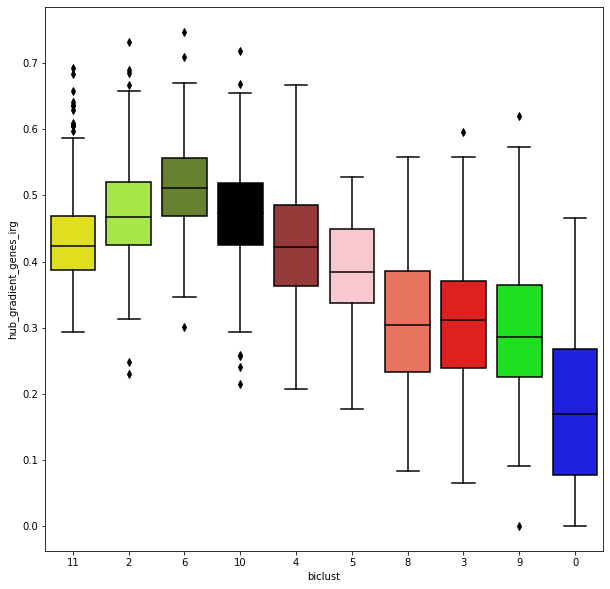

In [109]:
glist_d = np.array(irg_rnk_a.sort_values(by=['cor'],ascending=True)['gene'][0:30])#sc.get.rank_genes_groups_df(adA, group=i, key='hub_deg')['names'].squeeze().str.strip().tolist()

#print(len(glist))
adA.obs['hub_gradient_genes_irg'] = dt[dt.columns.intersection(glist_d)].sum(axis=1)/31

my_pal = {'0':'blue','1':'orange','2':'greenyellow','3':'red','4':'brown','5':'pink','6':'olivedrab','7':'cyan','8':'tomato','9':'lime','10':'black','11':'yellow'}
sns.boxplot(x = adA.obs['biclust'],
        y = adA.obs['hub_gradient_genes_irg'],
        order=['11','2', '6','10',  '4',  '5', '8',  '3','9', '0'],palette=my_pal)#,hue = adA.obs['sex']





In [110]:
x_hat_df[np.append(glist_u,glist_d)].to_csv('/Users/xueerchen/Downloads/bc_visium_mod/signature_v5_res/gradient_genes_hubs_exp.csv')

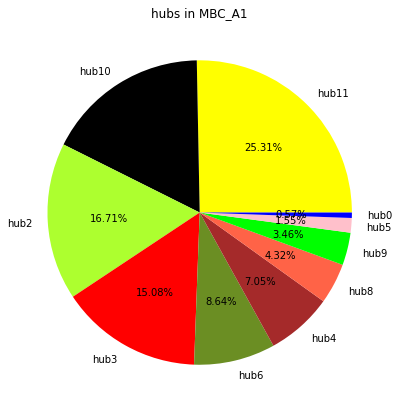

In [112]:
from matplotlib import pyplot as plt
import numpy as np
ttt = pd.DataFrame(biclust_r.loc[gsva_scores1.index,'cluster'].value_counts()/biclust_r.shape[0])

bicl = ['hub'+str(ii) for ii in ttt.index.values]
val = biclust_r.loc[gsva_scores1.index,'cluster'].value_counts()#/biclust_r.shape[0]

colours = {'hub0':'blue','hub1':'orange','hub2':'greenyellow','hub3':'red','hub4':'brown','hub5':'pink','hub6':'olivedrab','hub7':'cyan','hub8':'tomato','hub9':'lime','hub10':'black','hub11':'yellow'} 

#ax[0].pie(sizes,labels=labels,colors=[colours[key] for key in labels])

fig = plt.figure(figsize =(10, 7))
plt.pie(val, labels = bicl,autopct='%1.2f%%',colors=[colours[key] for key in bicl])
plt.title('hubs in MBC_A1')
# my_pal = {'0':'blue','1':'orange','2':'greenyellow','3':'red','4':'brown','5':'pink','6':'olivedrab','7':'cyan','8':'grey','9':'green','10':'black'} 
# show plot
plt.show()